In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter

import seaborn as sns
import squarify

from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
import matplotlib.pyplot as plt
import networkx as nx

#pandas profiling
from pandas_profiling import ProfileReport
#SKlearn preprocessing and model selection tools

from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, normalize, MinMaxScaler, OneHotEncoder, LabelEncoder
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV

#SKlearn clustering tools
from sklearn.impute import KNNImputer
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from sklearn.metrics import silhouette_score, silhouette_samples, classification_report, confusion_matrix, precision_score
from sklearn.cluster import KMeans

#DT 
from sklearn.tree import DecisionTreeClassifier, export_graphviz

#other packages
import statistics
from math import ceil
plt.rcParams['figure.figsize'] = (15, 9)

sns.set()

### Import and merge data

In [2]:
complete_orders = pd.read_csv('./CSV/complete_orders.csv')
del complete_orders['Unnamed: 0']
complete_orders

,department_id,department,product_id,product_name,order_id,add_to_cart_order,reordered,user_id,order_number,order_dow,order_hour_of_day,days_since_prior_order,k_labels
0,1,frozen,38,frozen meals,11,1,1,143742,4,Monday,19,23.0,1
1,13,pantry,19,oils vinegars,11,5,1,143742,4,Monday,19,23.0,1
2,15,canned goods,59,canned meals beans,11,3,1,143742,4,Monday,19,23.0,1
3,19,snacks,107,chips pretzels,11,4,1,143742,4,Monday,19,23.0,1
4,20,deli,67,fresh dips tapenades,11,2,1,143742,4,Monday,19,23.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1928528,21,missing,100,missing,1296769,1,1,50727,10,Friday,12,15.0,0
1928529,21,missing,100,missing,1648925,1,1,9568,8,Thursday,16,6.0,0
1928530,21,missing,100,missing,1955853,1,1,200270,3,Saturday,23,13.0,0
1928531,21,missing,100,missing,2574710,1,0,205651,6,Tuesday,16,30.0,0


### Split by Clusters

Use value on Klabels to split by each cluster of customers

<b>1. Do Exploratory Data Analysis on the Population of each cluster: get a better identifier than cluster_nbr
   
   2. Mine association rules from each cluster: compare size and compare from cluster to cluster.

In [3]:
cluster_0 = complete_orders.loc[complete_orders['k_labels'] == 0]
cluster_1 = complete_orders.loc[complete_orders['k_labels'] == 1]
cluster_2 = complete_orders.loc[complete_orders['k_labels'] == 2]
cluster_3 = complete_orders.loc[complete_orders['k_labels'] == 3]
cluster_4 = complete_orders.loc[complete_orders['k_labels'] == 4]

### Cluster 0

#### Data Exploration

In [4]:
print(f'Number of unique customers in cluster: {len(cluster_0.user_id.unique())}\n'
      f'Number of unique orders made by customers in cluster: {len(cluster_0.order_id.unique())}')

Number of unique customers in cluster: 39044
Number of unique orders made by customers in cluster: 58982


In [5]:
cluster_0.isna().sum()

department_id                 0
department                    0
product_id                    0
product_name                  0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    10779
k_labels                      0
dtype: int64

In [6]:
cluster_0.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,423129.0,NaN,NaN,NaN,9.936223,6.253239,1.0,4.0,7.0,16.0,21.0
department,423129,21,produce,119503,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,423129.0,NaN,NaN,NaN,70.701734,38.133022,1.0,31.0,81.0,107.0,134.0
product_name,423129,134,fresh fruits,46237,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,423129.0,NaN,NaN,NaN,1710633.309508,989273.031519,150.0,847298.0,1704497.0,2570097.0,3421074.0
add_to_cart_order,423129.0,NaN,NaN,NaN,7.072585,6.591121,1.0,2.0,5.0,10.0,83.0
reordered,423129.0,NaN,NaN,NaN,0.563514,0.49595,0.0,0.0,1.0,1.0,1.0
user_id,423129.0,NaN,NaN,NaN,103187.241784,59465.402819,3.0,51561.0,103686.0,154519.0,206201.0
order_number,423129.0,NaN,NaN,NaN,13.312167,13.974574,1.0,4.0,8.0,17.0,100.0
order_dow,423129,7,Tuesday,129764,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Plots - Customer Preferences

1. Department Preferences, 
2. Number of Purchases
3. Number of items in purchase

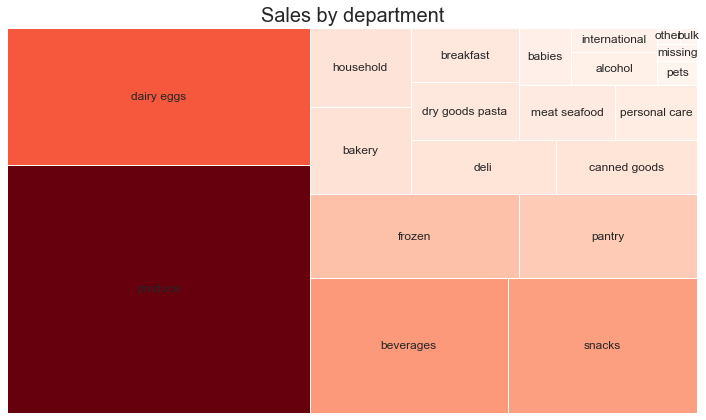

In [7]:
cmap = matplotlib.cm.Reds
mini = min(cluster_0['department'].value_counts())
maxi = max(cluster_0['department'].value_counts())
norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
colors = [cmap(norm(i)) for i in cluster_0['department'].value_counts()]



plt.figure(figsize=(10, 6))
squarify.plot(sizes=cluster_0['department'].value_counts(), label=cluster_0['department'].value_counts().index, color=colors);
plt.title('Sales by department', fontsize=20)
plt.axis('off');
plt.tight_layout()

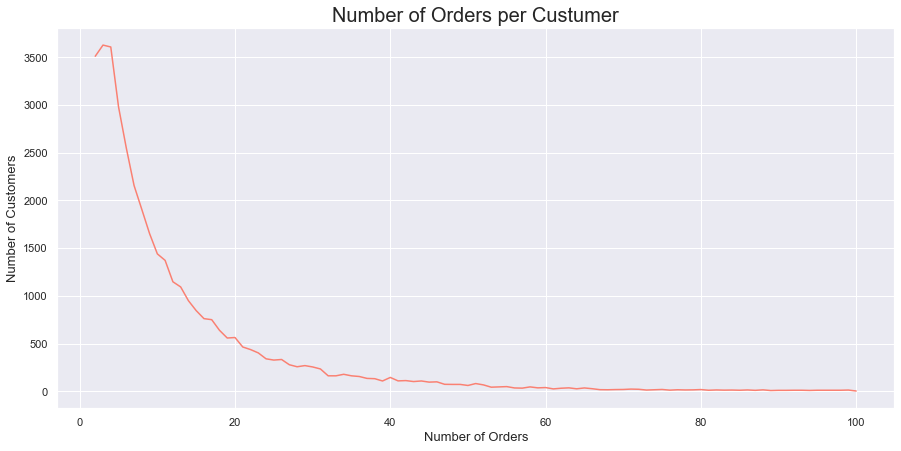

In [8]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_0.groupby("user_id")["order_number"].aggregate(np.max).reset_index()["order_number"].value_counts()

sns.lineplot(x=plot_data.index,
                 y=plot_data.values,
                 color="salmon")

plt.ylabel('Number of Customers', fontsize=13)
plt.xlabel('Number of Orders', fontsize=13)

plt.title("Number of Orders per Custumer", fontsize=20)
plt.show()

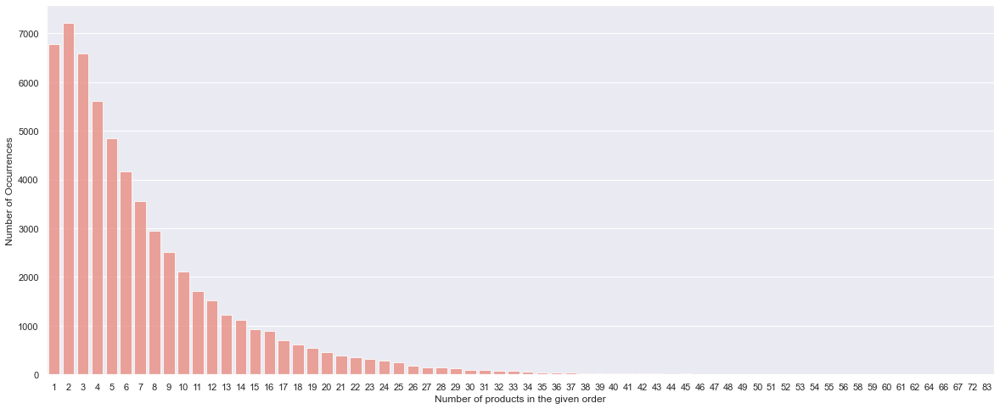

In [9]:
#No. of products per order on an average
grouped_df = cluster_0.groupby("order_id")["add_to_cart_order"].aggregate("max").reset_index()
cnt_srs = grouped_df.add_to_cart_order.value_counts()

plt.figure(figsize=(20,8))
sns.barplot(x = cnt_srs.index, y = cnt_srs.values, alpha=0.8, color = 'salmon')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Number of products in the given order', fontsize=12)
#plt.xticks(rotation='vertical')
plt.show()

### Customer General Behavior

1. Time of day Preferences
2. Hour Preferences
3. Time between orders by the given customer

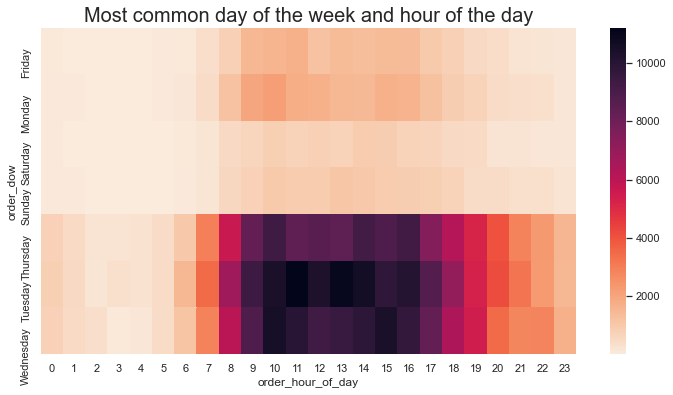

In [10]:
plot_data = cluster_0.groupby(["order_dow", "order_hour_of_day"])["order_number"].agg("count").reset_index()
plot_data = plot_data.pivot('order_dow', 'order_hour_of_day', 'order_number')

plt.figure(figsize=(12,6))
sns.heatmap(plot_data,cmap=sns.color_palette("rocket_r", as_cmap=True))
plt.title("Most common day of the week and hour of the day", fontsize=20)
plt.show()

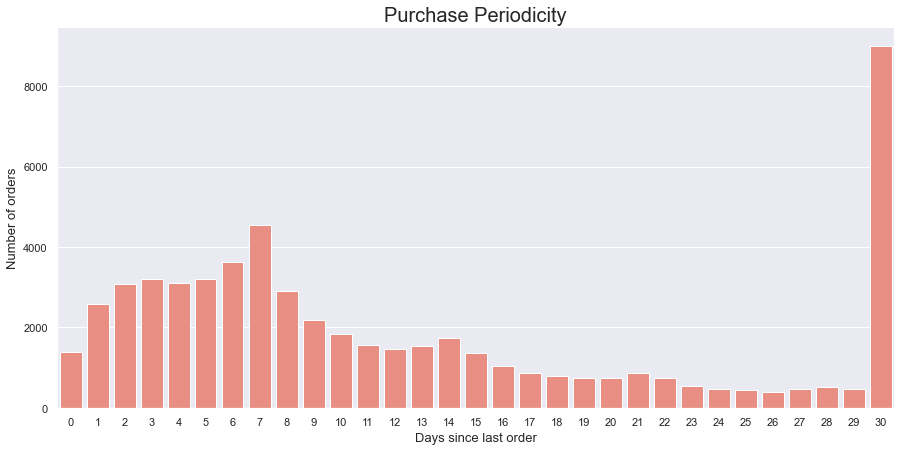

In [11]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_0.groupby('order_id')['days_since_prior_order'].mean().reset_index()['days_since_prior_order'].value_counts()

sns.barplot(x=plot_data.index,
                 y=plot_data.values,
                 color="salmon",
           )
ax.xaxis.set_major_formatter(FormatStrFormatter('%.0f'))
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days since last order', fontsize=13)

plt.title("Purchase Periodicity", fontsize=20)
plt.show()

In [12]:
#Finding number of customers
'''## Defining a function to get unique count for user_id from orders.csv'''

def get_unique_count(x):             
    return len(np.unique(x))

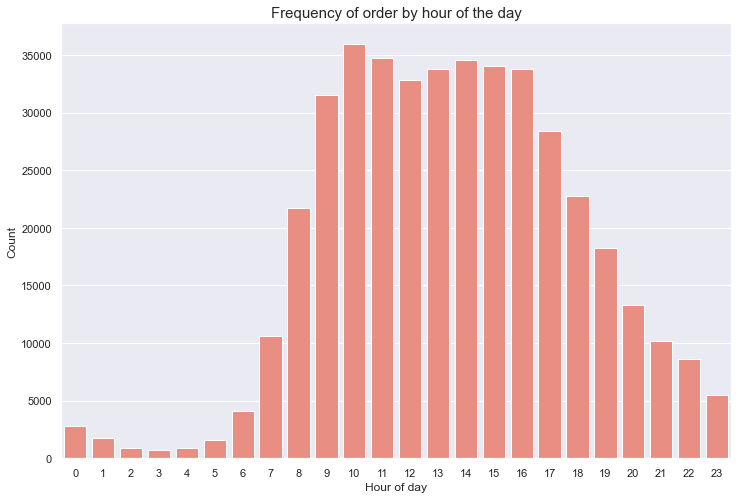

order_hour_of_day
0      374
1      224
2      137
3       91
4      109
5      191
6      559
7     1487
8     3052
9     4613
10    5192
11    4995
12    4632
13    4727
14    4799
15    4753
16    4700
17    3858
18    3147
19    2449
20    1826
21    1282
22    1081
23     704
Name: order_id, dtype: int64

In [13]:
#Figuring out which time of the day is the busiest
plt.figure(figsize=(12,8))
sns.countplot(x="order_hour_of_day", data=cluster_0, color='salmon')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Hour of day', fontsize=12)
plt.title("Frequency of order by hour of the day", fontsize=15)
plt.show()
cnt_hod = cluster_0.groupby('order_hour_of_day')['order_id'].aggregate(get_unique_count)
cnt_hod

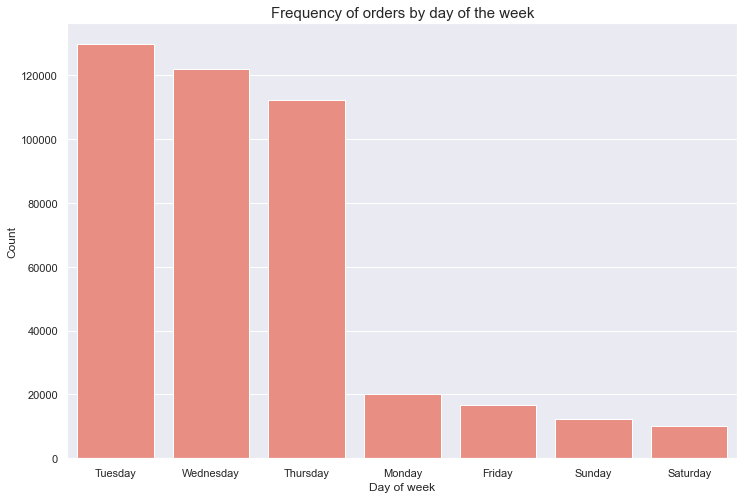

order_dow
Friday        4795
Monday        5745
Saturday      3000
Sunday        3607
Thursday     13072
Tuesday      14605
Wednesday    14158
Name: order_id, dtype: int64

In [14]:
#Finding out the busiest day of the week
plt.figure(figsize=(12,8))
sns.countplot(x="order_dow", data=cluster_0, order=cluster_0['order_dow'].value_counts().index, color='salmon')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Day of week', fontsize=12)
plt.title("Frequency of orders by day of the week", fontsize=15)
plt.show()
cnt_dow = cluster_0.groupby('order_dow')['order_id'].aggregate(get_unique_count)
cnt_dow

<b>39044 customers with 58982 orders.<b>
 

Overall observations: 
    
Low frequency buyers
Low lenght of purchase: 1 to 4 items at a time
    
Proneness to make purchases on Tuesdays, Wednesdays and Thursdays between 9 and 17.

Top 6 departments: Produce, Dairy Eggs, Beverages, Snacks, Frozen and Pantry

### Cluster 1

#### Data Exploration

In [15]:
print(f'Number of unique customers in cluster: {len(cluster_1.user_id.unique())}\n'
      f'Number of unique orders made by customers in cluster: {len(cluster_1.order_id.unique())}')

Number of unique customers in cluster: 15632
Number of unique orders made by customers in cluster: 37041


In [16]:
cluster_1.isna().sum()

department_id                 0
department                    0
product_id                    0
product_name                  0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    12953
k_labels                      0
dtype: int64

In [17]:
cluster_1.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,416044.0,NaN,NaN,NaN,10.104994,6.317445,1.0,4.0,9.0,16.0,21.0
department,416044,21,produce,120060,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,416044.0,NaN,NaN,NaN,71.287335,38.409745,1.0,31.0,83.0,107.0,134.0
product_name,416044,134,fresh fruits,48212,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,416044.0,NaN,NaN,NaN,1710059.433875,987709.942554,11.0,854502.0,1702497.0,2567620.0,3421080.0
add_to_cart_order,416044.0,NaN,NaN,NaN,8.603878,7.228071,1.0,3.0,7.0,12.0,109.0
reordered,416044.0,NaN,NaN,NaN,0.635241,0.481363,0.0,0.0,1.0,1.0,1.0
user_id,416044.0,NaN,NaN,NaN,103490.126979,59963.393587,21.0,51680.0,102573.0,155827.0,206208.0
order_number,416044.0,NaN,NaN,NaN,19.851146,19.013511,1.0,6.0,13.0,28.0,100.0
order_dow,416044,7,Monday,249614,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Plots - Customer Preferences

1. Department Preferences, 
2. Number of Purchases
3. Number of items in purchase

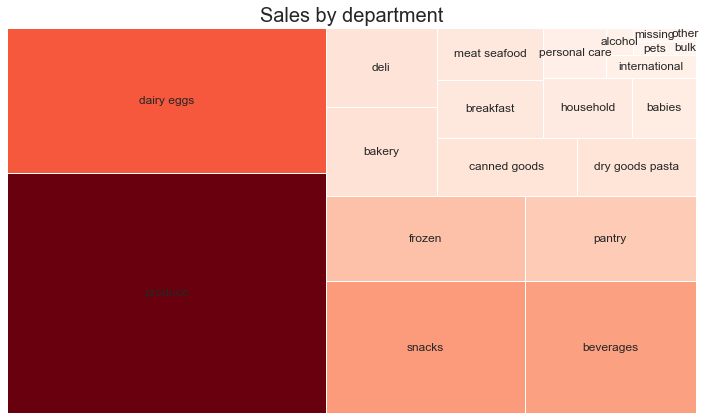

In [18]:
cmap = matplotlib.cm.Reds
mini = min(cluster_1['department'].value_counts())
maxi = max(cluster_1['department'].value_counts())
norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
colors = [cmap(norm(i)) for i in cluster_0['department'].value_counts()]



plt.figure(figsize=(10, 6))
squarify.plot(sizes=cluster_1['department'].value_counts(), label=cluster_1['department'].value_counts().index, color=colors);
plt.title('Sales by department', fontsize=20)
plt.axis('off');
plt.tight_layout()

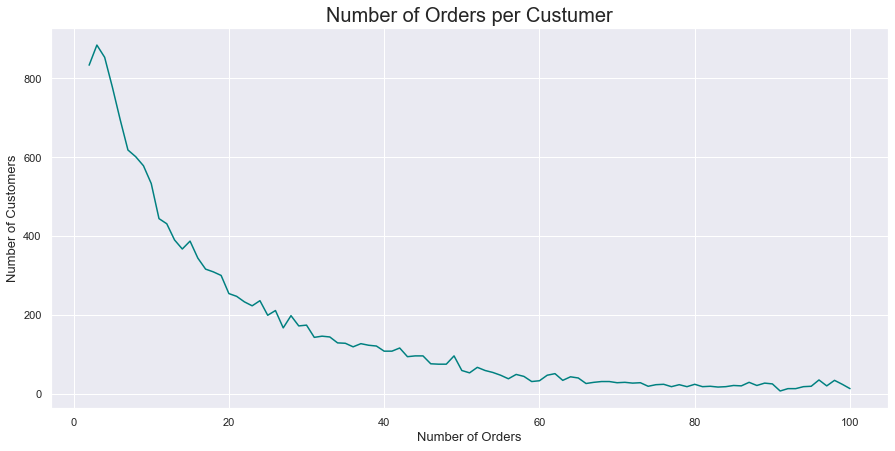

In [19]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_1.groupby("user_id")["order_number"].aggregate(np.max).reset_index()["order_number"].value_counts()

sns.lineplot(x=plot_data.index,
                 y=plot_data.values,
                 color="teal")

plt.ylabel('Number of Customers', fontsize=13)
plt.xlabel('Number of Orders', fontsize=13)

plt.title("Number of Orders per Custumer", fontsize=20)
plt.show()

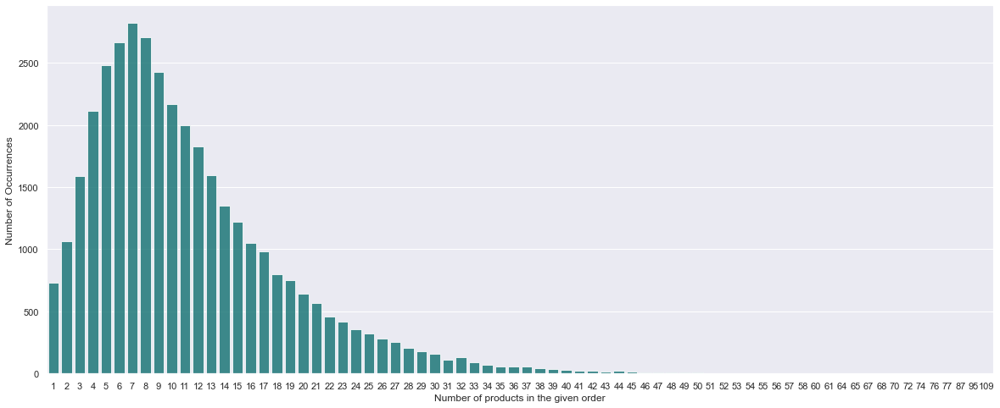

In [20]:
#No. of products per order on an average
grouped_df = cluster_1.groupby("order_id")["add_to_cart_order"].aggregate("max").reset_index()
cnt_srs = grouped_df.add_to_cart_order.value_counts()

plt.figure(figsize=(20,8))
sns.barplot(x = cnt_srs.index, y = cnt_srs.values, alpha=0.8, color = 'teal')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Number of products in the given order', fontsize=12)
#plt.xticks(rotation='vertical')
plt.show()

### Customer General Behavior

1. Time of day Preferences
2. Hour Preferences
3. Time between orders by the given customer

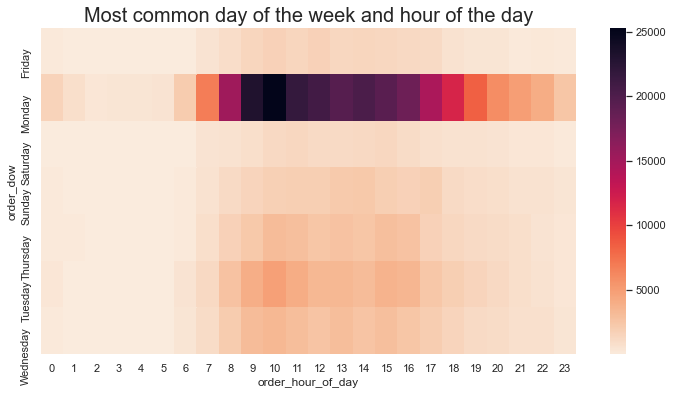

In [21]:
plot_data = cluster_1.groupby(["order_dow", "order_hour_of_day"])["order_number"].agg("count").reset_index()
plot_data = plot_data.pivot('order_dow', 'order_hour_of_day', 'order_number')

plt.figure(figsize=(12,6))
sns.heatmap(plot_data,cmap=sns.color_palette("rocket_r", as_cmap=True))
plt.title("Most common day of the week and hour of the day", fontsize=20)
plt.show()

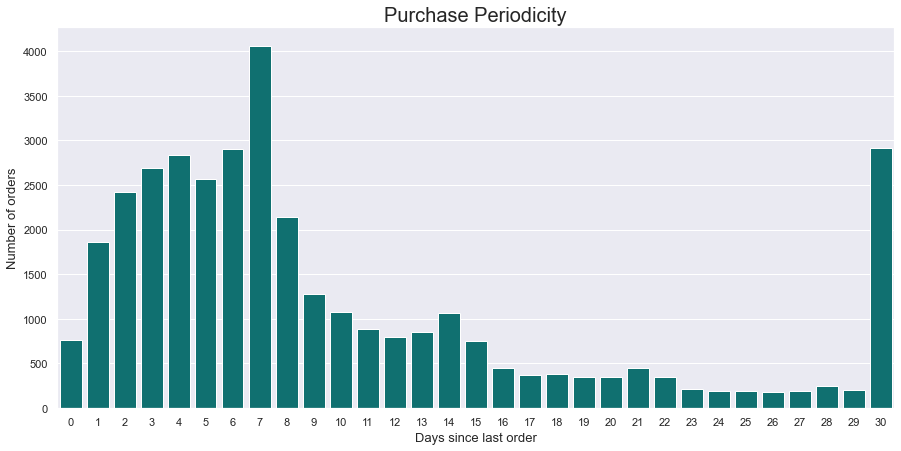

In [22]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_1.groupby('order_id')['days_since_prior_order'].mean().reset_index()['days_since_prior_order'].value_counts()

sns.barplot(x=plot_data.index,
                 y=plot_data.values,
                 color="teal",
           )
ax.xaxis.set_major_formatter(FormatStrFormatter('%.0f'))
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days since last order', fontsize=13)

plt.title("Purchase Periodicity", fontsize=20)
plt.show()

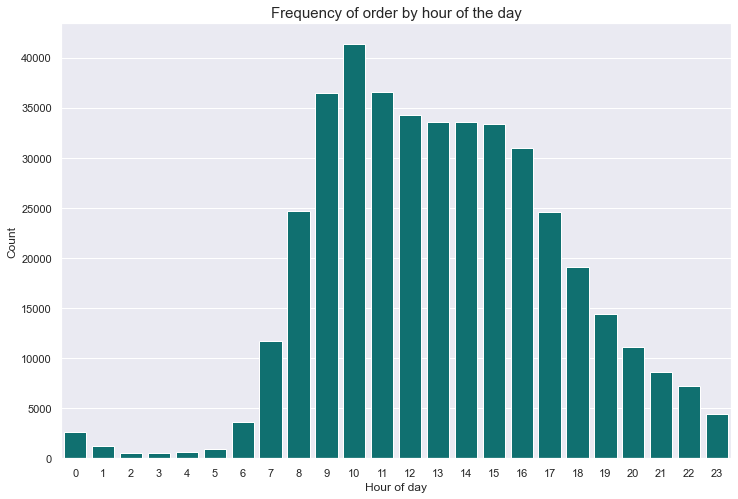

order_hour_of_day
0      221
1      104
2       50
3       41
4       61
5       87
6      318
7     1034
8     2151
9     3231
10    3633
11    3274
12    2982
13    2952
14    3021
15    3019
16    2805
17    2240
18    1815
19    1345
20     988
21     715
22     587
23     367
Name: order_id, dtype: int64

In [23]:
#Figuring out which time of the day is the busiest
plt.figure(figsize=(12,8))
sns.countplot(x="order_hour_of_day", data=cluster_1, color='teal')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Hour of day', fontsize=12)
plt.title("Frequency of order by hour of the day", fontsize=15)
plt.show()
cnt_hod = cluster_1.groupby('order_hour_of_day')['order_id'].aggregate(get_unique_count)
cnt_hod

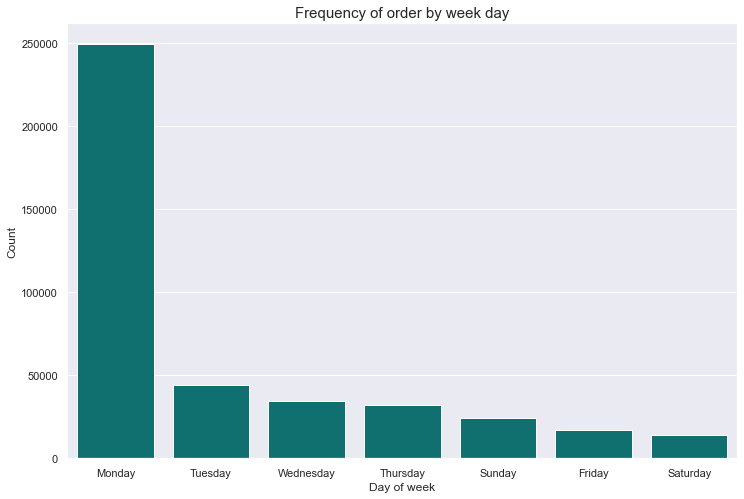

order_dow
Friday        2052
Monday       20235
Saturday      1612
Sunday        2434
Thursday      3178
Tuesday       4120
Wednesday     3410
Name: order_id, dtype: int64

In [24]:
#Finding out the busiest day of the week
plt.figure(figsize=(12,8))
sns.countplot(x="order_dow", data=cluster_1, order=cluster_1['order_dow'].value_counts().index, color='teal')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Day of week', fontsize=12)
plt.title("Frequency of order by week day", fontsize=15)
plt.show()
cnt_dow = cluster_1.groupby('order_dow')['order_id'].aggregate(get_unique_count)
cnt_dow

<b>15632 customers with 37041 orders.<b>
 

Overall observations: 
    
Weekly buyers
Reasonable lenght of purchase: 6 to 14 items at a time
    
Proneness to make purchases on Monday 9 and 17.

Top 6 departments: Produce, Dairy Eggs, Snacks, Beverages, Frozen, Pantry

### Cluster 2

#### Data Exploration

In [25]:
print(f'Number of unique customers in cluster: {len(cluster_2.user_id.unique())}\n'
      f'Number of unique orders made by customers in cluster: {len(cluster_2.order_id.unique())}')

Number of unique customers in cluster: 17900
Number of unique orders made by customers in cluster: 37000


In [26]:
cluster_2.isna().sum()

department_id                 0
department                    0
product_id                    0
product_name                  0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    14299
k_labels                      0
dtype: int64

In [27]:
cluster_2.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,432847.0,NaN,NaN,NaN,9.786899,6.278105,1.0,4.0,8.0,16.0,21.0
department,432847,21,produce,132980,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,432847.0,NaN,NaN,NaN,71.425478,38.222933,1.0,31.0,83.0,107.0,134.0
product_name,432847,134,fresh vegetables,50543,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,432847.0,NaN,NaN,NaN,1710734.495143,981596.579888,56.0,863546.0,1709098.0,2557560.0,3421027.0
add_to_cart_order,432847.0,NaN,NaN,NaN,8.844183,7.183001,1.0,3.0,7.0,12.0,93.0
reordered,432847.0,NaN,NaN,NaN,0.610888,0.487549,0.0,0.0,1.0,1.0,1.0
user_id,432847.0,NaN,NaN,NaN,103198.443794,59091.538541,7.0,52167.0,102776.0,153953.5,206206.0
order_number,432847.0,NaN,NaN,NaN,17.246286,16.722911,1.0,5.0,12.0,24.0,100.0
order_dow,432847,7,Sunday,293608,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Plots - Customer Preferences

1. Department Preferences, 
2. Number of Purchases
3. Number of items in purchase

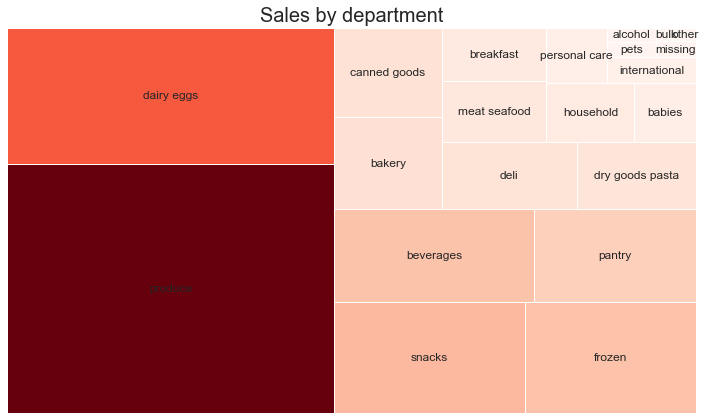

In [28]:
cmap = matplotlib.cm.Reds
mini = min(cluster_2['department'].value_counts())
maxi = max(cluster_2['department'].value_counts())
norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
colors = [cmap(norm(i)) for i in cluster_2['department'].value_counts()]



plt.figure(figsize=(10, 6))
squarify.plot(sizes=cluster_2['department'].value_counts(), label=cluster_2['department'].value_counts().index, color=colors);
plt.title('Sales by department', fontsize=20)
plt.axis('off');
plt.tight_layout()

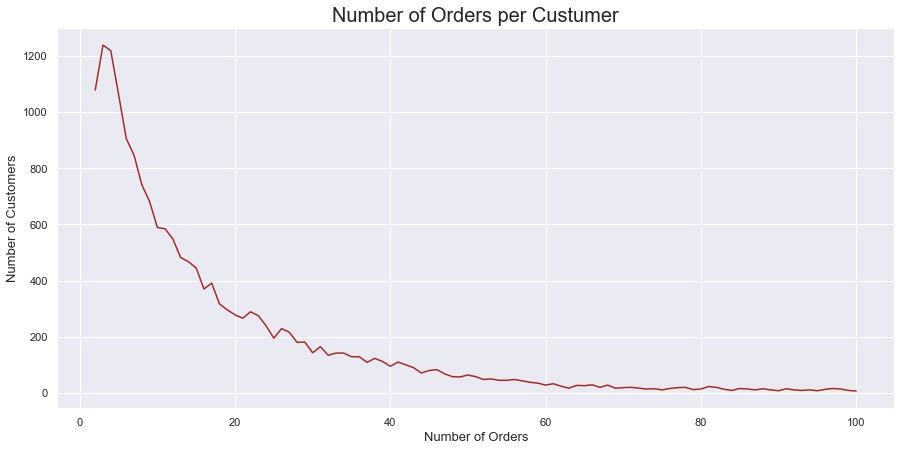

In [29]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_2.groupby("user_id")["order_number"].aggregate(np.max).reset_index()["order_number"].value_counts()

sns.lineplot(x=plot_data.index,
                 y=plot_data.values,
                 color="brown")

plt.ylabel('Number of Customers', fontsize=13)
plt.xlabel('Number of Orders', fontsize=13)

plt.title("Number of Orders per Custumer", fontsize=20)
plt.show()

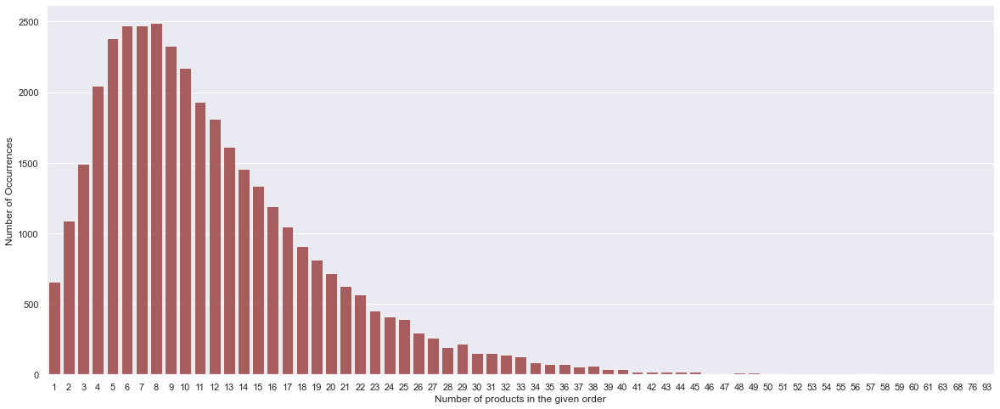

In [30]:
#No. of products per order on an average
grouped_df = cluster_2.groupby("order_id")["add_to_cart_order"].aggregate("max").reset_index()
cnt_srs = grouped_df.add_to_cart_order.value_counts()

plt.figure(figsize=(20,8))
sns.barplot(x = cnt_srs.index, y = cnt_srs.values, alpha=0.8, color = 'brown')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Number of products in the given order', fontsize=12)
#plt.xticks(rotation='vertical')
plt.show()

### Customer General Behavior

1. Time of day Preferences
2. Hour Preferences
3. Time between orders by the given customer

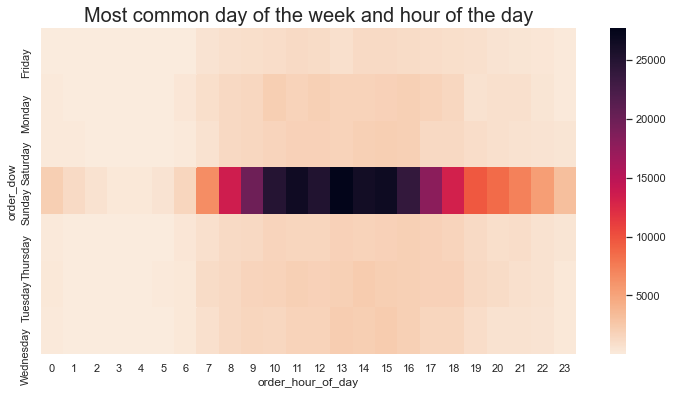

In [31]:
plot_data = cluster_2.groupby(["order_dow", "order_hour_of_day"])["order_number"].agg("count").reset_index()
plot_data = plot_data.pivot('order_dow', 'order_hour_of_day', 'order_number')

plt.figure(figsize=(12,6))
sns.heatmap(plot_data,cmap=sns.color_palette("rocket_r", as_cmap=True))
plt.title("Most common day of the week and hour of the day", fontsize=20)
plt.show()

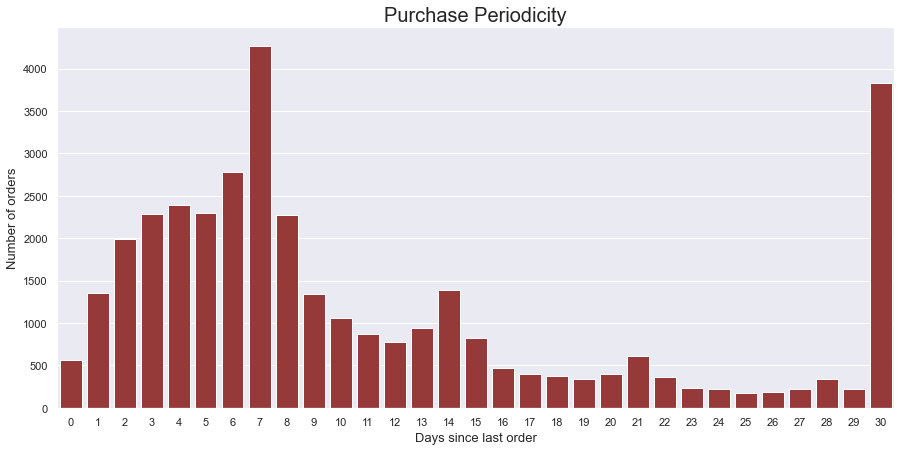

In [32]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_2.groupby('order_id')['days_since_prior_order'].mean().reset_index()['days_since_prior_order'].value_counts()

sns.barplot(x=plot_data.index,
                 y=plot_data.values,
                 color="brown",
           )
ax.xaxis.set_major_formatter(FormatStrFormatter('%.0f'))
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days since last order', fontsize=13)

plt.title("Purchase Periodicity", fontsize=20)
plt.show()

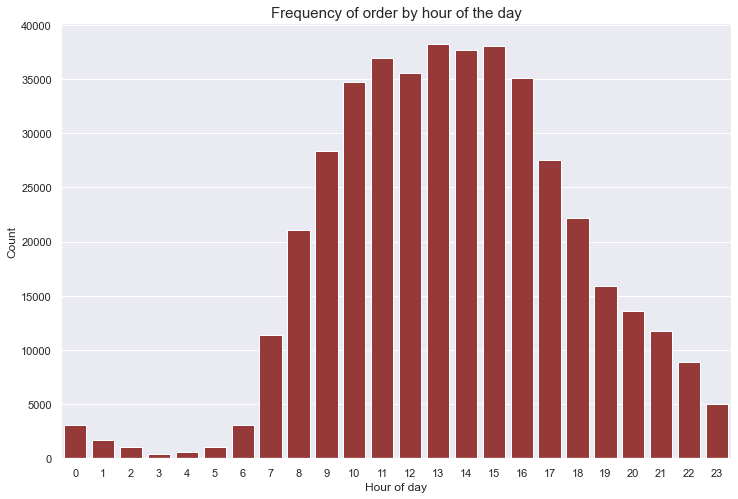

order_hour_of_day
0      260
1      150
2       91
3       41
4       64
5       94
6      272
7      984
8     1720
9     2373
10    2858
11    3051
12    2995
13    3131
14    3224
15    3259
16    3055
17    2533
18    2053
19    1496
20    1212
21     934
22     744
23     406
Name: order_id, dtype: int64

In [33]:
#Figuring out which time of the day is the busiest
plt.figure(figsize=(12,8))
sns.countplot(x="order_hour_of_day", data=cluster_2, color='brown')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Hour of day', fontsize=12)
plt.title("Frequency of order by hour of the day", fontsize=15)
plt.show()
cnt_hod = cluster_2.groupby('order_hour_of_day')['order_id'].aggregate(get_unique_count)
cnt_hod

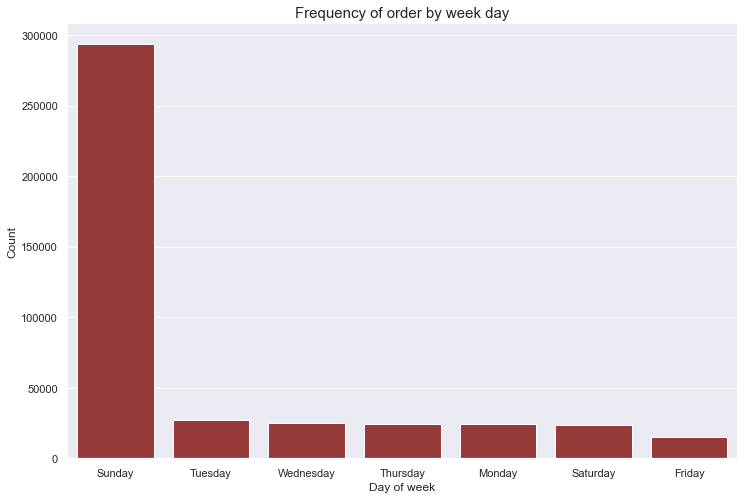

order_dow
Friday        1764
Monday        2578
Saturday      2460
Sunday       22854
Thursday      2372
Tuesday       2565
Wednesday     2407
Name: order_id, dtype: int64

In [34]:
#Finding out the busiest day of the week
plt.figure(figsize=(12,8))
sns.countplot(x="order_dow", data=cluster_2, order=cluster_2['order_dow'].value_counts().index, color='brown')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Day of week', fontsize=12)
plt.title("Frequency of order by week day", fontsize=15)
plt.show()
cnt_dow = cluster_2.groupby('order_dow')['order_id'].aggregate(get_unique_count)
cnt_dow

<b>17900 customers with 37000 orders.<b>
 

Overall observations: 
    
Weekly buyers
Reasonable lenght of purchase: 5 to 15 items at a time
    
Proneness to make purchases on Sunday 9 and 17.

Top 6 departments: Produce, Dairy Eggs, Snacks, Frozen, Beverages, Pantry

### Cluster 3

#### Data Exploration

In [35]:
print(f'Number of unique customers in cluster: {len(cluster_3.user_id.unique())}\n'
      f'Number of unique orders made by customers in cluster: {len(cluster_3.order_id.unique())}')

Number of unique customers in cluster: 12936
Number of unique orders made by customers in cluster: 27569


In [36]:
cluster_3.isna().sum()

department_id                 0
department                    0
product_id                    0
product_name                  0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    10657
k_labels                      0
dtype: int64

In [37]:
cluster_3.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,316478.0,NaN,NaN,NaN,9.789211,6.265077,1.0,4.0,9.0,16.0,21.0
department,316478,21,produce,94074,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,316478.0,NaN,NaN,NaN,71.194279,38.028093,1.0,31.0,83.0,106.0,134.0
product_name,316478,134,fresh vegetables,36252,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,316478.0,NaN,NaN,NaN,1705356.718296,982616.596413,10.0,860354.0,1699970.5,2546933.0,3420899.0
add_to_cart_order,316478.0,NaN,NaN,NaN,8.777915,7.215667,1.0,3.0,7.0,12.0,92.0
reordered,316478.0,NaN,NaN,NaN,0.601859,0.489516,0.0,0.0,1.0,1.0,1.0
user_id,316478.0,NaN,NaN,NaN,103266.745022,59472.338552,50.0,51748.0,102993.0,154645.0,206197.0
order_number,316478.0,NaN,NaN,NaN,17.777741,17.368283,1.0,5.0,12.0,24.0,100.0
order_dow,316478,7,Saturday,202109,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Plots - Customer Preferences

1. Department Preferences, 
2. Number of Purchases
3. Number of items in purchase

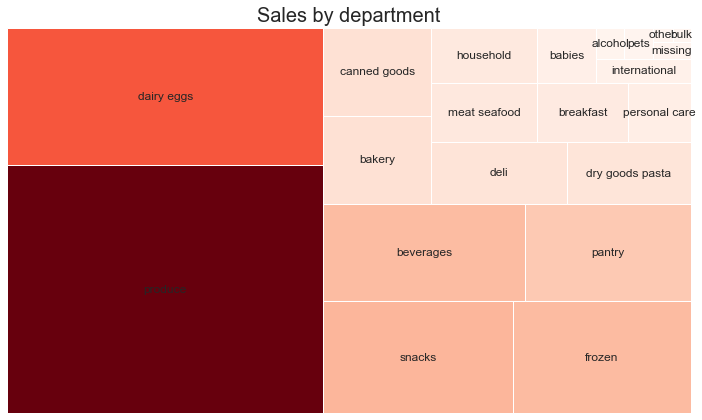

In [38]:
cmap = matplotlib.cm.Reds
mini = min(cluster_3['department'].value_counts())
maxi = max(cluster_3['department'].value_counts())
norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
colors = [cmap(norm(i)) for i in cluster_3['department'].value_counts()]



plt.figure(figsize=(10, 6))
squarify.plot(sizes=cluster_3['department'].value_counts(), label=cluster_3['department'].value_counts().index, color=colors);
plt.title('Sales by department', fontsize=20)
plt.axis('off');
plt.tight_layout()

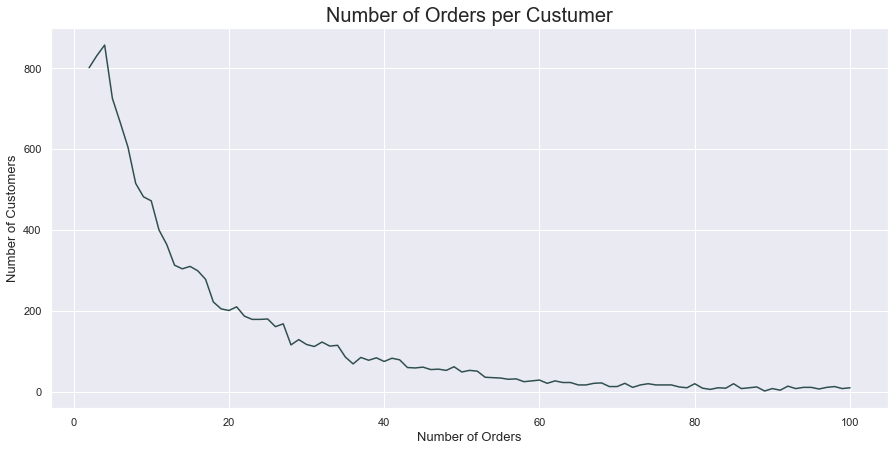

In [39]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_3.groupby("user_id")["order_number"].aggregate(np.max).reset_index()["order_number"].value_counts()

sns.lineplot(x=plot_data.index,
                 y=plot_data.values,
                 color="darkslategray")

plt.ylabel('Number of Customers', fontsize=13)
plt.xlabel('Number of Orders', fontsize=13)

plt.title("Number of Orders per Custumer", fontsize=20)
plt.show()

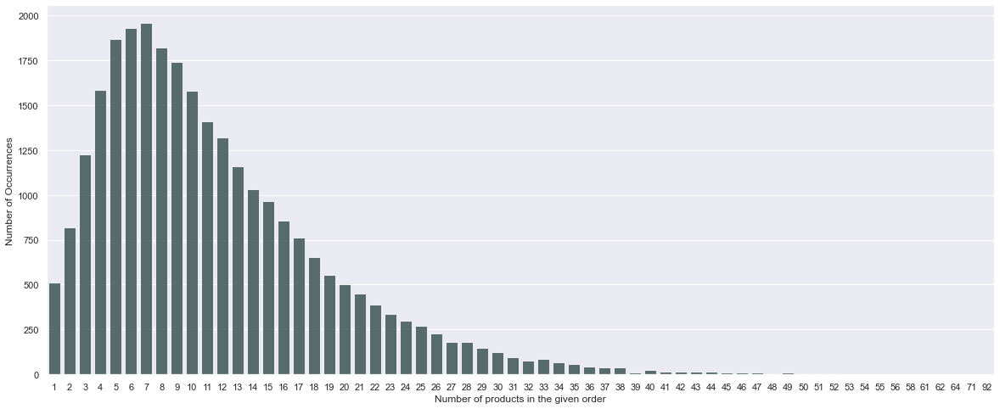

In [40]:
#No. of products per order on an average
grouped_df = cluster_3.groupby("order_id")["add_to_cart_order"].aggregate("max").reset_index()
cnt_srs = grouped_df.add_to_cart_order.value_counts()

plt.figure(figsize=(20,8))
sns.barplot(x = cnt_srs.index, y = cnt_srs.values, alpha=0.8, color = 'darkslategray')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Number of products in the given order', fontsize=12)
#plt.xticks(rotation='vertical')
plt.show()

### Customer General Behavior

1. Time of day Preferences
2. Hour Preferences
3. Time between orders by the given customer

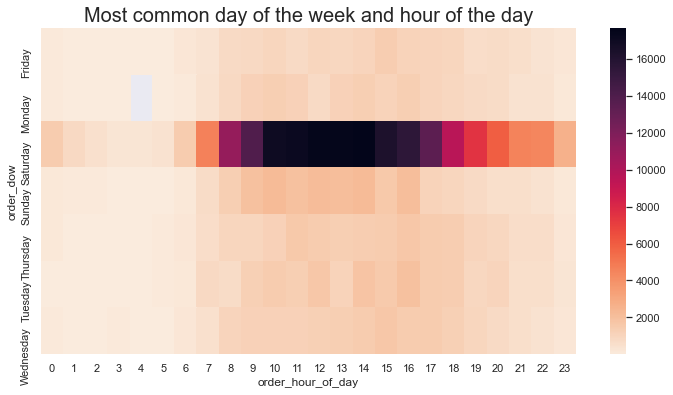

In [41]:
plot_data = cluster_3.groupby(["order_dow", "order_hour_of_day"])["order_number"].agg("count").reset_index()
plot_data = plot_data.pivot('order_dow', 'order_hour_of_day', 'order_number')

plt.figure(figsize=(12,6))
sns.heatmap(plot_data,cmap=sns.color_palette("rocket_r", as_cmap=True))
plt.title("Most common day of the week and hour of the day", fontsize=20)
plt.show()

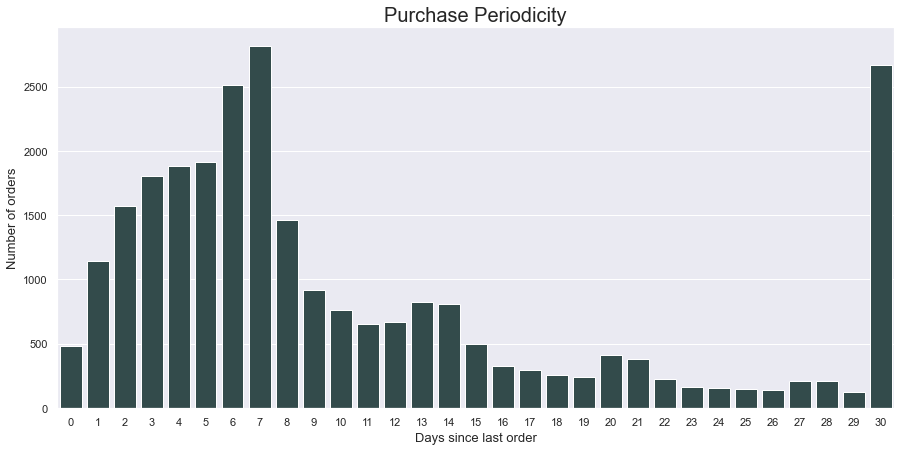

In [42]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_3.groupby('order_id')['days_since_prior_order'].mean().reset_index()['days_since_prior_order'].value_counts()

sns.barplot(x=plot_data.index,
                 y=plot_data.values,
                 color="darkslategray",
           )
ax.xaxis.set_major_formatter(FormatStrFormatter('%.0f'))
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days since last order', fontsize=13)

plt.title("Purchase Periodicity", fontsize=20)
plt.show()

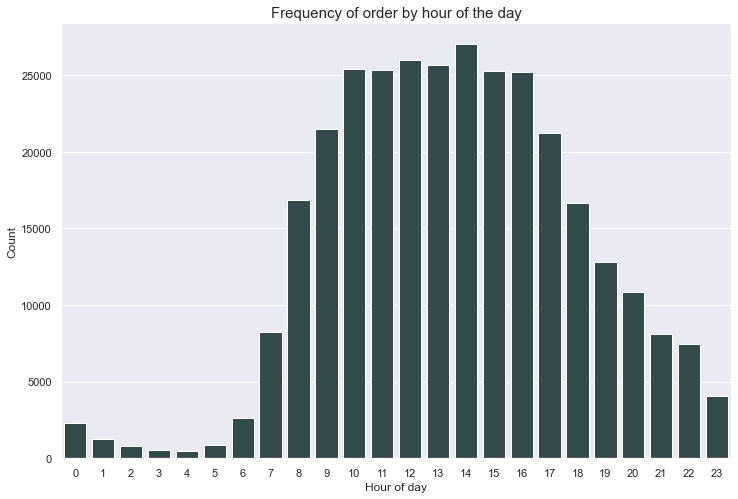

order_hour_of_day
0      207
1      116
2       67
3       46
4       37
5       72
6      242
7      713
8     1361
9     1824
10    2126
11    2161
12    2202
13    2201
14    2316
15    2251
16    2234
17    1955
18    1590
19    1230
20     974
21     701
22     590
23     353
Name: order_id, dtype: int64

In [43]:
#Figuring out which time of the day is the busiest
plt.figure(figsize=(12,8))
sns.countplot(x="order_hour_of_day", data=cluster_3, color='darkslategray')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Hour of day', fontsize=12)
plt.title("Frequency of order by hour of the day", fontsize=15)
plt.show()
cnt_hod = cluster_3.groupby('order_hour_of_day')['order_id'].aggregate(get_unique_count)
cnt_hod

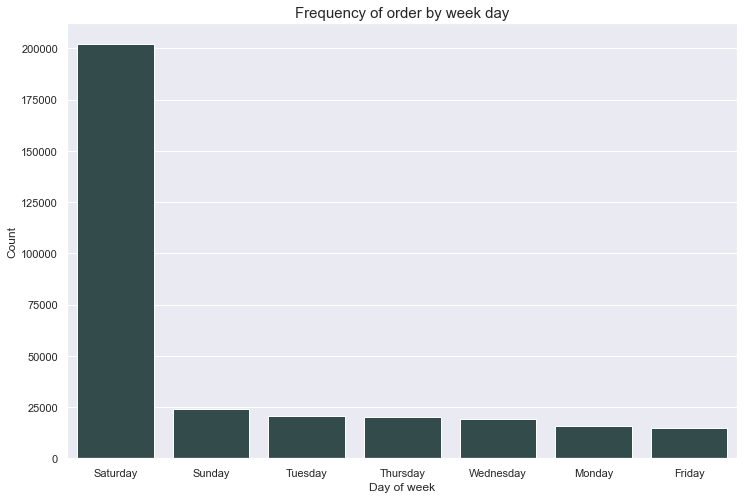

order_dow
Friday        1590
Monday        1755
Saturday     15936
Sunday        2488
Thursday      1952
Tuesday       1985
Wednesday     1863
Name: order_id, dtype: int64

In [44]:
#Finding out the busiest day of the week
plt.figure(figsize=(12,8))
sns.countplot(x="order_dow", data=cluster_3, order=cluster_3['order_dow'].value_counts().index, color='darkslategray')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Day of week', fontsize=12)
plt.title("Frequency of order by week day", fontsize=15)
plt.show()
cnt_dow = cluster_3.groupby('order_dow')['order_id'].aggregate(get_unique_count)
cnt_dow

<b>12936 customers with 27569 orders.

Overall observations:

Weekly buyers Reasonable lenght of purchase: 5 to 15 items at a time

Proneness to make purchases on Saturday 9 and 17.

Top 6 departments: Produce, Dairy Eggs, Snacks, Frozen, Beverages, Pantry

### Cluster 4

#### Data Exploration

In [45]:
print(f'Number of unique customers in cluster: {len(cluster_4.user_id.unique())}\n'
      f'Number of unique orders made by customers in cluster: {len(cluster_4.order_id.unique())}')

Number of unique customers in cluster: 12183
Number of unique orders made by customers in cluster: 30422


In [46]:
cluster_4.isna().sum()

department_id                 0
department                    0
product_id                    0
product_name                  0
order_id                      0
add_to_cart_order             0
reordered                     0
user_id                       0
order_number                  0
order_dow                     0
order_hour_of_day             0
days_since_prior_order    10535
k_labels                      0
dtype: int64

In [47]:
cluster_4.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
department_id,340035.0,NaN,NaN,NaN,10.025839,6.294966,1.0,4.0,9.0,16.0,21.0
department,340035,21,produce,96595,NaN,NaN,NaN,NaN,NaN,NaN,NaN
product_id,340035.0,NaN,NaN,NaN,71.465552,38.230885,1.0,31.0,83.0,107.0,134.0
product_name,340035,134,fresh fruits,38582,NaN,NaN,NaN,NaN,NaN,NaN,NaN
order_id,340035.0,NaN,NaN,NaN,1700284.573594,989478.117537,122.0,838354.0,1709224.0,2554595.0,3420964.0
add_to_cart_order,340035.0,NaN,NaN,NaN,8.684674,7.48639,1.0,3.0,7.0,12.0,137.0
reordered,340035.0,NaN,NaN,NaN,0.638578,0.480413,0.0,0.0,1.0,1.0,1.0
user_id,340035.0,NaN,NaN,NaN,101962.019721,59431.651651,2.0,50470.0,100982.0,153740.0,206209.0
order_number,340035.0,NaN,NaN,NaN,21.187395,19.871064,1.0,6.0,14.0,30.0,100.0
order_dow,340035,7,Friday,188520,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Plots - Customer Preferences

1. Department Preferences, 
2. Number of Purchases
3. Number of items in purchase

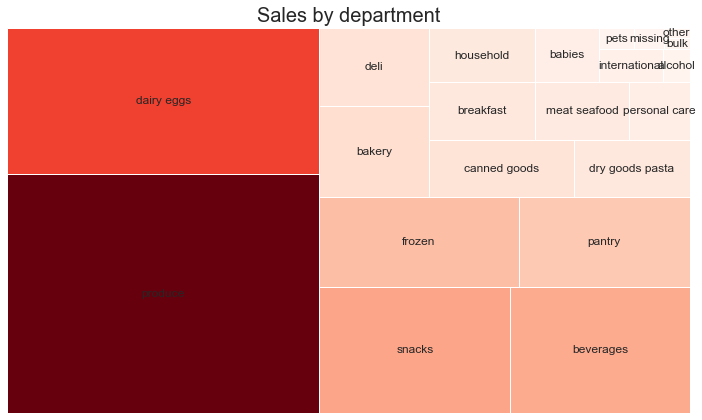

In [48]:
cmap = matplotlib.cm.Reds
mini = min(cluster_4['department'].value_counts())
maxi = max(cluster_4['department'].value_counts())
norm = matplotlib.colors.Normalize(vmin=mini, vmax=maxi)
colors = [cmap(norm(i)) for i in cluster_4['department'].value_counts()]



plt.figure(figsize=(10, 6))
squarify.plot(sizes=cluster_4['department'].value_counts(), label=cluster_4['department'].value_counts().index, color=colors);
plt.title('Sales by department', fontsize=20)
plt.axis('off');
plt.tight_layout()

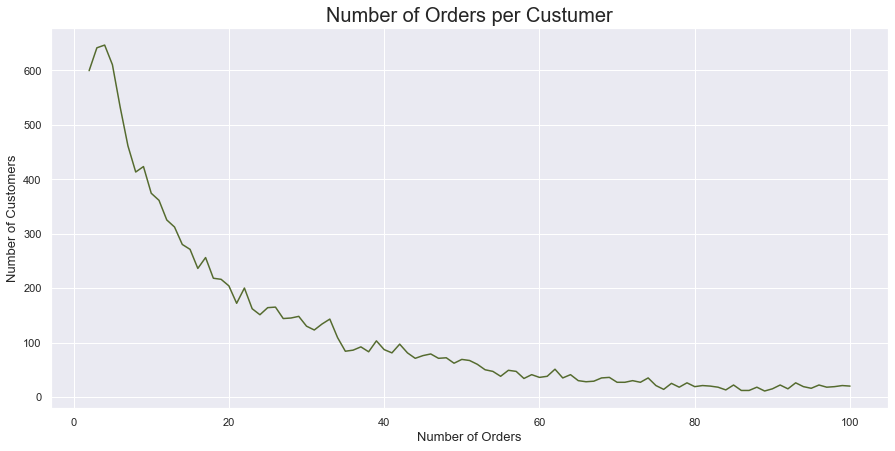

In [49]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_4.groupby("user_id")["order_number"].aggregate(np.max).reset_index()["order_number"].value_counts()

sns.lineplot(x=plot_data.index,
                 y=plot_data.values,
                 color="darkolivegreen")

plt.ylabel('Number of Customers', fontsize=13)
plt.xlabel('Number of Orders', fontsize=13)

plt.title("Number of Orders per Custumer", fontsize=20)
plt.show()

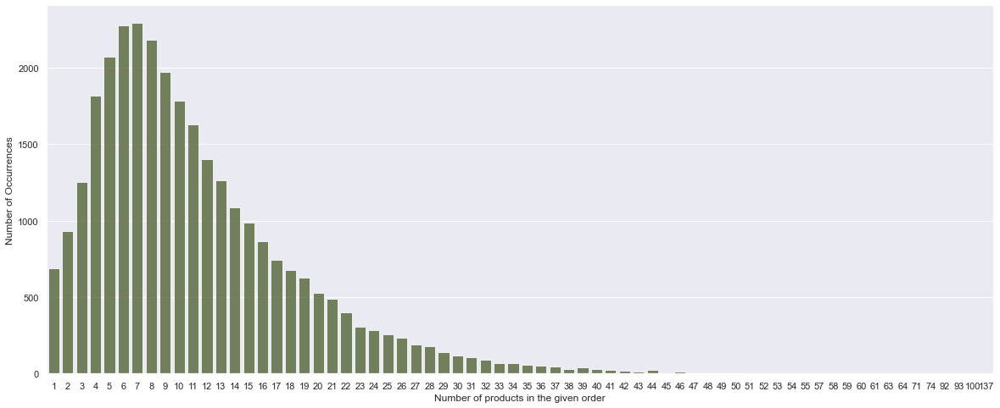

In [50]:
#No. of products per order on an average
grouped_df = cluster_4.groupby("order_id")["add_to_cart_order"].aggregate("max").reset_index()
cnt_srs = grouped_df.add_to_cart_order.value_counts()

plt.figure(figsize=(20,8))
sns.barplot(x = cnt_srs.index, y = cnt_srs.values, alpha=0.8, color = 'darkolivegreen')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Number of products in the given order', fontsize=12)
#plt.xticks(rotation='vertical')
plt.show()

### Customer General Behavior

1. Time of day Preferences
2. Hour Preferences
3. Time between orders by the given customer

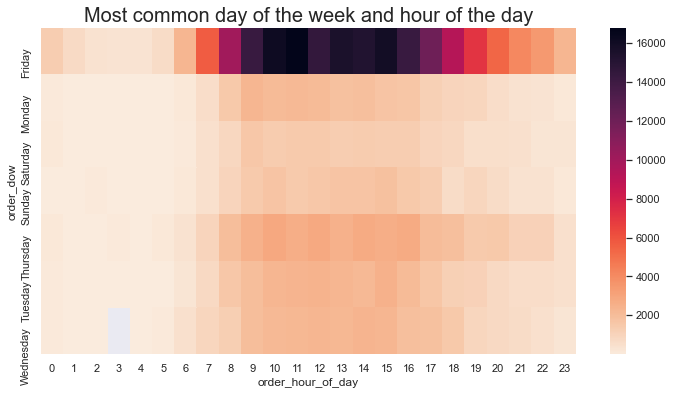

In [51]:
plot_data = cluster_4.groupby(["order_dow", "order_hour_of_day"])["order_number"].agg("count").reset_index()
plot_data = plot_data.pivot('order_dow', 'order_hour_of_day', 'order_number')

plt.figure(figsize=(12,6))
sns.heatmap(plot_data,cmap=sns.color_palette("rocket_r", as_cmap=True))
plt.title("Most common day of the week and hour of the day", fontsize=20)
plt.show()

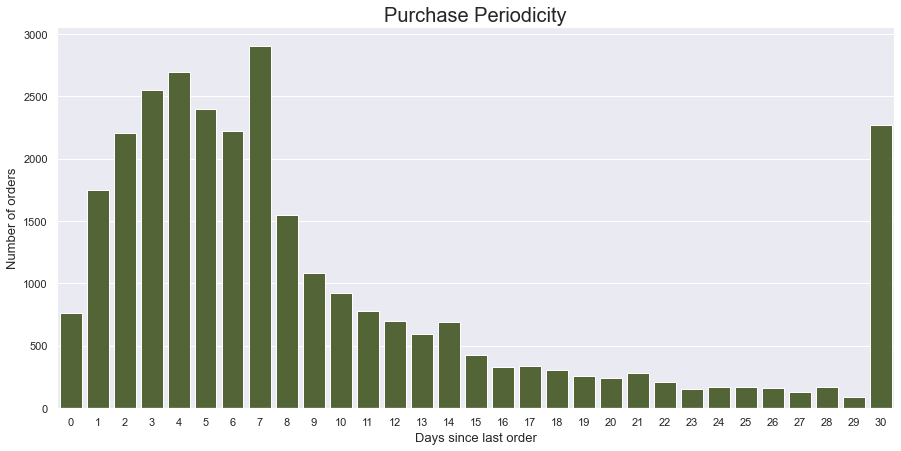

In [52]:
f, ax = plt.subplots(figsize=(15, 7))
plot_data = cluster_4.groupby('order_id')['days_since_prior_order'].mean().reset_index()['days_since_prior_order'].value_counts()

sns.barplot(x=plot_data.index,
                 y=plot_data.values,
                 color="darkolivegreen",
           )
ax.xaxis.set_major_formatter(FormatStrFormatter('%.0f'))
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days since last order', fontsize=13)

plt.title("Purchase Periodicity", fontsize=20)
plt.show()

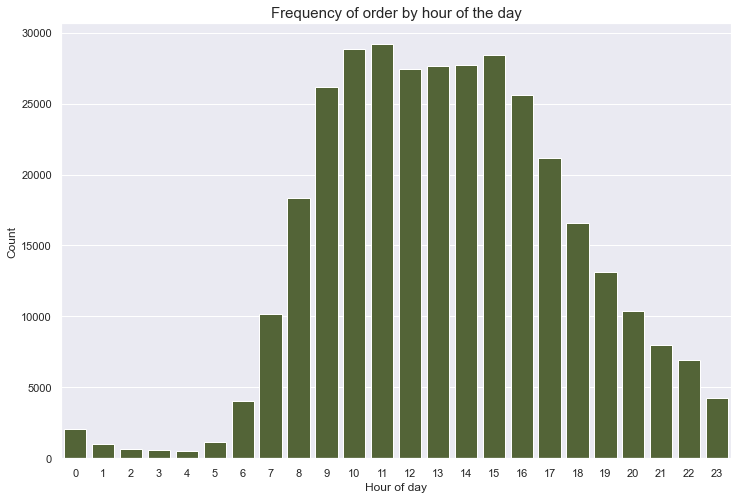

order_hour_of_day
0      183
1       94
2       58
3       51
4       44
5       97
6      330
7      886
8     1610
9     2313
10    2607
11    2535
12    2399
13    2460
14    2481
15    2593
16    2384
17    1965
18    1592
19    1238
20     915
21     659
22     552
23     376
Name: order_id, dtype: int64

In [53]:
#Figuring out which time of the day is the busiest
plt.figure(figsize=(12,8))
sns.countplot(x="order_hour_of_day", data=cluster_4, color='darkolivegreen')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Hour of day', fontsize=12)
plt.title("Frequency of order by hour of the day", fontsize=15)
plt.show()
cnt_hod = cluster_4.groupby('order_hour_of_day')['order_id'].aggregate(get_unique_count)
cnt_hod

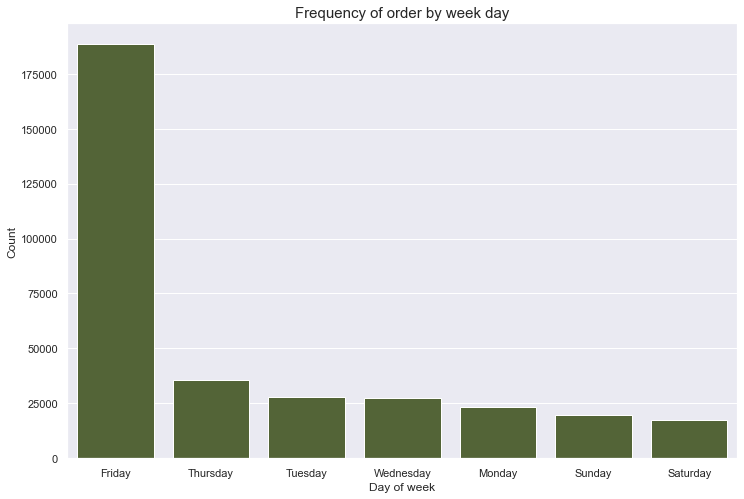

order_dow
Friday       15248
Monday        2490
Saturday      1837
Sunday        2062
Thursday      3338
Tuesday       2778
Wednesday     2669
Name: order_id, dtype: int64

In [54]:
#Finding out the busiest day of the week
plt.figure(figsize=(12,8))
sns.countplot(x="order_dow", data=cluster_4, order=cluster_4['order_dow'].value_counts().index, color='darkolivegreen')
plt.ylabel('Count', fontsize=12)
plt.xlabel('Day of week', fontsize=12)
plt.title("Frequency of order by week day", fontsize=15)
plt.show()
cnt_dow = cluster_4.groupby('order_dow')['order_id'].aggregate(get_unique_count)
cnt_dow

<b>12181 customers with 30422 orders.

Overall observations:

Weekly buyers Reasonable lenght of purchase: 5 to 15 items at a time

Proneness to make purchases on Friday 9 and 17.

Top 6 departments: Produce, Dairy Eggs, Snacks, Beverages, Frozen, Pantry

## Cluster Specific association rules:

The most significant difference between different groups of customers seems to be the preferred day of the week.
There are some minor differences in preffered department from group to group - The top 6 sought after departments are always the same, even if the preferences in 3rd to 6th place may vary from customer type to customer type.

We will now look for intra-cluster association rules and compare the results with the results obtained for the general population.


We will start with a general overview of each cluster with some Exploration. Down below we'll go into more detail on the product associations.

### Cluster 0 - The Occasional Buyers

In [55]:
comp_ord = cluster_0[['product_name', 'order_id']]
# Pivot the data - lines as orders and products as columns
pt = pd.pivot_table(comp_ord, index='order_id', columns='product_name', 
                    aggfunc=lambda x: 1 if len(x)>0 else 0).fillna(0)
pt

product_name,air fresheners candles,asian foods,baby accessories,baby bath body care,baby food formula,bakery desserts,baking ingredients,baking supplies decor,beauty,beers coolers,...,spreads,tea,tofu meat alternatives,tortillas flat bread,trail mix snack mix,trash bags liners,vitamins supplements,water seltzer sparkling water,white wines,yogurt
order_id,,,,,,,,,,,,,,,,,,,,,
150,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
172,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
205,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
243,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
532,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420923,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3420952,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3420977,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [56]:
# Apply the APRIORI algorithm to get frequent itemsets
# Rules supported in at least 3% of the transactions (more info at http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/apriori/)
frequent_itemsets = apriori(pt, min_support=0.01, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.030620,(asian foods)
1,0.028144,(baby food formula)
2,0.055135,(baking ingredients)
3,0.014208,(beers coolers)
4,0.010732,(body lotions soap)
...,...,...
942,0.013106,"(fresh fruits, fresh vegetables, packaged vege..."
943,0.010240,"(fresh fruits, fresh vegetables, packaged chee..."
944,0.015784,"(fresh fruits, fresh vegetables, packaged vege..."
945,0.017124,"(fresh fruits, fresh vegetables, packaged vege..."


In [57]:
# Generate the association rules - by confidence
rulesConfidence = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.00)
rulesConfidence.sort_values(by='lift', ascending=False, inplace=True)
rulesConfidence['rule'] = rulesConfidence['antecedents'].astype(str) + '-->' + rulesConfidence['consequents'].astype(str)  
rulesConfidence

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule
319,(dry pasta),(pasta sauce),0.042013,0.037995,0.011427,0.271994,7.158734,0.009831,1.321424,frozenset({'dry pasta'})-->frozenset({'pasta s...
318,(pasta sauce),(dry pasta),0.037995,0.042013,0.011427,0.300759,7.158734,0.009831,1.370038,frozenset({'pasta sauce'})-->frozenset({'dry p...
4352,"(packaged vegetables fruits, packaged cheese)","(fresh fruits, fresh vegetables, chips pretzels)",0.064308,0.034349,0.010122,0.157395,4.582174,0.007913,1.146030,"frozenset({'packaged vegetables fruits', 'pack..."
4333,"(fresh fruits, fresh vegetables, chips pretzels)","(packaged vegetables fruits, packaged cheese)",0.034349,0.064308,0.010122,0.294669,4.582174,0.007913,1.326601,"frozenset({'fresh fruits', 'fresh vegetables',..."
4469,"(fresh vegetables, yogurt)","(packaged vegetables fruits, fresh fruits, pac...",0.078600,0.048710,0.017124,0.217860,4.472618,0.013295,1.216266,"frozenset({'fresh vegetables', 'yogurt'})-->fr..."
...,...,...,...,...,...,...,...,...,...,...
753,(soft drinks),(packaged vegetables fruits),0.086772,0.258825,0.015445,0.177999,0.687721,-0.007013,0.901672,frozenset({'soft drinks'})-->frozenset({'packa...
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...


In [58]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Scatter(
    x = rulesConfidence['support'],
    y = rulesConfidence['confidence'],
    mode='markers',
    hovertext = rulesConfidence['rule'],
    marker=dict(
        size=16,
        color = rulesConfidence['lift'], #set color equal to a variable
        colorscale='OrRd', # one of plotly colorscales
        showscale=True, 
    )), 
    layout=go.Layout(
        xaxis=dict(autorange = True,
            title=dict(text="Support")),
        yaxis=dict(autorange = True, visible=True, showticklabels=True,
            title = dict(text="Confidence")),
        title=dict(text='Support, Confidence and Lift in Occasional Buyers',
                   x=0.5, xanchor='center')))

fig.show()

In [59]:
# Generate the association rules - by lift
rulesLift = association_rules(frequent_itemsets, metric="lift", min_threshold=0)
rulesLift.sort_values(by='lift', ascending=False, inplace=True)
rulesLift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
319,(dry pasta),(pasta sauce),0.042013,0.037995,0.011427,0.271994,7.158734,0.009831,1.321424
318,(pasta sauce),(dry pasta),0.037995,0.042013,0.011427,0.300759,7.158734,0.009831,1.370038
4352,"(packaged vegetables fruits, packaged cheese)","(fresh fruits, fresh vegetables, chips pretzels)",0.064308,0.034349,0.010122,0.157395,4.582174,0.007913,1.146030
4333,"(fresh fruits, fresh vegetables, chips pretzels)","(packaged vegetables fruits, packaged cheese)",0.034349,0.064308,0.010122,0.294669,4.582174,0.007913,1.326601
4469,"(fresh vegetables, yogurt)","(packaged vegetables fruits, fresh fruits, pac...",0.078600,0.048710,0.017124,0.217860,4.472618,0.013295,1.216266


In [60]:
# Add a column with the length
frequent_itemsets['length'] = frequent_itemsets['itemsets'].apply(lambda x: len(x))

# Length>=2 and Support>=0.2
frequent_itemsets[(frequent_itemsets['length'] >= 2) & (frequent_itemsets['support'] >= 0.2)]

,support,itemsets,length
285,0.201197,"(fresh fruits, fresh vegetables)",2


In [61]:
# High Confidence and high Lift - complementary products -> confidence above 0.7 and lift above 1.5
comp_placeholder = rulesConfidence.loc[(rulesConfidence['confidence'] >= 0.70) & (rulesConfidence['lift'] >= 1.5)]

comp_placeholder['Cluster'] = 0
#store in df
complementary = comp_placeholder.sort_values(by = 'confidence', ascending = False)
complementary

<ipython-input-61-d150b7b8d4a0>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
3555,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.012614,0.309213,0.011410,0.904570,2.925394,0.007510,7.238670,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",0
3540,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.023940,0.309213,0.021600,0.902266,2.917944,0.014197,7.068053,"frozenset({'packaged vegetables fruits', 'fres...",0
4482,"(packaged vegetables fruits, soy lactosefree, ...",(fresh fruits),0.012021,0.416805,0.010766,0.895628,2.148792,0.005756,5.587637,"frozenset({'packaged vegetables fruits', 'soy ...",0
3526,"(packaged cheese, fresh herbs, fresh fruits)",(fresh vegetables),0.011732,0.309213,0.010461,0.891618,2.883509,0.006833,6.373662,"frozenset({'packaged cheese', 'fresh herbs', '...",0
4302,"(packaged vegetables fruits, bread, fresh vege...",(fresh fruits),0.012444,0.416805,0.011003,0.884196,2.121366,0.005816,5.036059,"frozenset({'packaged vegetables fruits', 'brea...",0
...,...,...,...,...,...,...,...,...,...,...,...
2267,"(packaged produce, packaged vegetables fruits)",(fresh fruits),0.024143,0.416805,0.016954,0.702247,1.684833,0.006891,1.958654,"frozenset({'packaged produce', 'packaged veget...",0
3737,"(packaged vegetables fruits, fresh fruits, nut...",(fresh vegetables),0.017582,0.309213,0.012343,0.702025,2.270361,0.006906,2.318272,"frozenset({'packaged vegetables fruits', 'fres...",0
1271,"(lunch meat, chips pretzels)",(fresh fruits),0.016073,0.416805,0.011275,0.701477,1.682985,0.004575,1.953600,"frozenset({'lunch meat', 'chips pretzels'})-->...",0
2225,"(other creams cheeses, yogurt)",(fresh fruits),0.017887,0.416805,0.012546,0.701422,1.682853,0.005091,1.953240,"frozenset({'other creams cheeses', 'yogurt'})-...",0


In [62]:
# Substitute products , lift < 1
rulesLift2 = association_rules(frequent_itemsets, metric="lift", min_threshold=0.0)
rulesLift2.sort_values(by='lift', ascending=True, inplace=True)
rulesLift2 = rulesLift2[rulesLift2['lift'] < 1]
rulesLift2['rule'] = rulesLift2['antecedents'].astype(str) + '-->' + rulesLift2['consequents'].astype(str) 
rulesLift2['Cluster'] = 0

substitutes = rulesLift2
substitutes

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1938,"(fresh fruits, fresh vegetables)",(soft drinks),0.201197,0.086772,0.011020,0.054774,0.631236,-0.006438,0.966147,"frozenset({'fresh fruits', 'fresh vegetables'}...",0
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...,0
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...,0
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...,0
752,(packaged vegetables fruits),(soft drinks),0.258825,0.086772,0.015445,0.059675,0.687721,-0.007013,0.971183,frozenset({'packaged vegetables fruits'})-->fr...,0
753,(soft drinks),(packaged vegetables fruits),0.086772,0.258825,0.015445,0.177999,0.687721,-0.007013,0.901672,frozenset({'soft drinks'})-->frozenset({'packa...,0
445,(fresh fruits),(soft drinks),0.416805,0.086772,0.026313,0.063130,0.727543,-0.009854,0.974765,frozenset({'fresh fruits'})-->frozenset({'soft...,0
444,(soft drinks),(fresh fruits),0.086772,0.416805,0.026313,0.303243,0.727543,-0.009854,0.837014,frozenset({'soft drinks'})-->frozenset({'fresh...,0
666,(packaged produce),(milk),0.078668,0.173002,0.010359,0.131681,0.761154,-0.003251,0.952413,frozenset({'packaged produce'})-->frozenset({'...,0
667,(milk),(packaged produce),0.173002,0.078668,0.010359,0.059878,0.761154,-0.003251,0.980014,frozenset({'milk'})-->frozenset({'packaged pro...,0


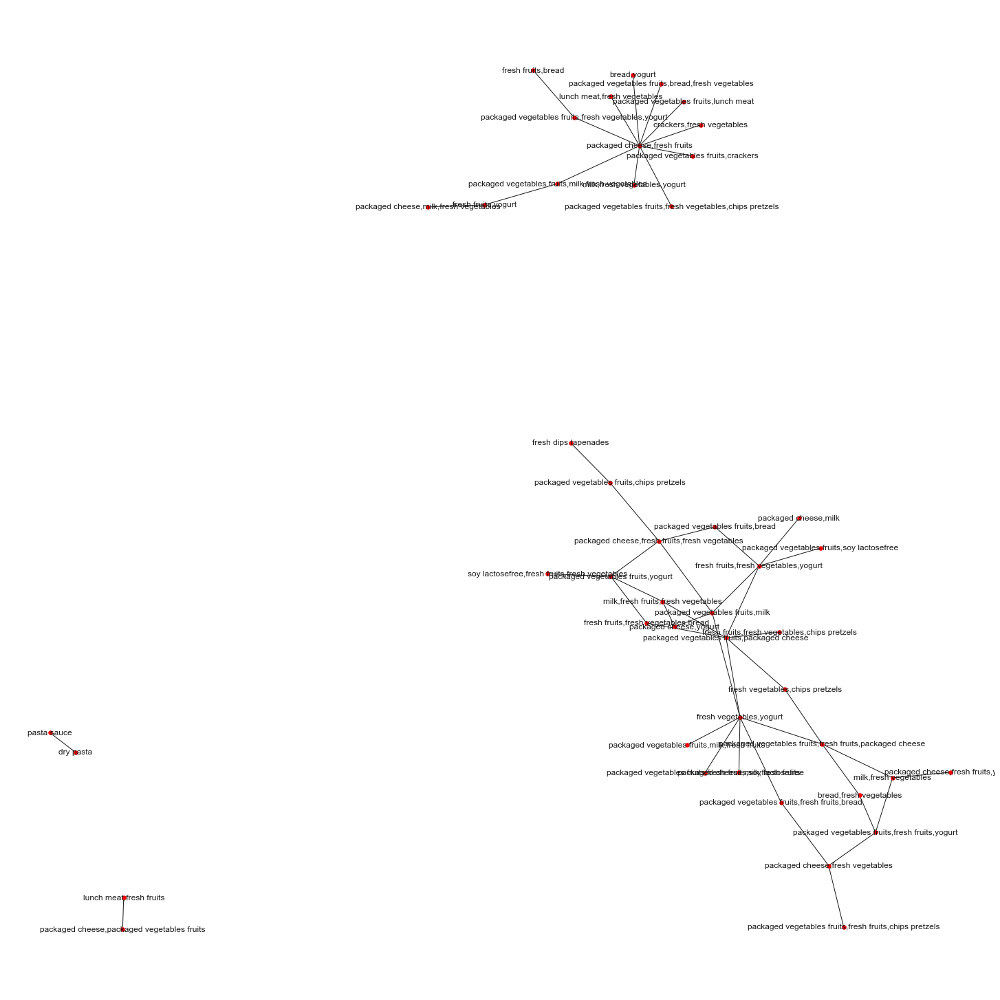

In [63]:
### Plot a basic network graph of the top 50 confidence rules
# Create a copy of the rules and transform the frozensets to strings
rulesToPlot = rulesConfidence.copy(deep=True)
rulesToPlot['LHS'] = [','.join(list(x)) for x in rulesToPlot['antecedents']]
rulesToPlot['RHS'] = [','.join(list(x)) for x in rulesToPlot['consequents']]
# Remove duplicate if reversed rules
rulesToPlot['sortedRow'] = [sorted([a,b]) for a,b in zip(rulesToPlot.LHS, rulesToPlot.RHS)]
rulesToPlot['sortedRow'] = rulesToPlot['sortedRow'].astype(str)
rulesToPlot.drop_duplicates(subset=['sortedRow'], inplace=True)
# Plot
rulesToPlot=rulesToPlot[:50]
fig = plt.figure(figsize=(20, 20)) 
G = nx.from_pandas_edgelist(rulesToPlot, 'LHS', 'RHS')  
# Each node is an itemset (either source or target) and the edges connect the itemsets if they consist of a high confidence rule
nx.draw(G, with_labels=True, node_size=30, node_color="red", pos=nx.spring_layout(G))
plt.axis('equal')
plt.show()
#fig.savefig('figure.svg')
# TRY TO PLOT THE DIRECTION OF SOURCE -> TARGET

### Cluster 1 - Monday Weekly Purchasers 

In [64]:
comp_ord = cluster_1[['product_name', 'order_id']]
# Pivot the data - lines as orders and products as columns
pt = pd.pivot_table(comp_ord, index='order_id', columns='product_name', 
                    aggfunc=lambda x: 1 if len(x)>0 else 0).fillna(0)
pt

product_name,air fresheners candles,asian foods,baby accessories,baby bath body care,baby food formula,bakery desserts,baking ingredients,baking supplies decor,beauty,beers coolers,...,spreads,tea,tofu meat alternatives,tortillas flat bread,trail mix snack mix,trash bags liners,vitamins supplements,water seltzer sparkling water,white wines,yogurt
order_id,,,,,,,,,,,,,,,,,,,,,
11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
62,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
565,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
718,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420910,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3420959,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3420968,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [65]:
# Apply the APRIORI algorithm to get frequent itemsets
# Rules supported in at least 5% of the transactions (more info at http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/apriori/)
frequent_itemsets = apriori(pt, min_support=0.01, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.045949,(asian foods)
1,0.055101,(baby food formula)
2,0.010205,(bakery desserts)
3,0.080586,(baking ingredients)
4,0.185416,(bread)
...,...,...
3764,0.010799,"(fresh fruits, fresh vegetables, packaged vege..."
3765,0.010475,"(fresh fruits, fresh vegetables, frozen produc..."
3766,0.010853,"(fresh fruits, lunch meat, fresh vegetables, p..."
3767,0.019708,"(fresh fruits, fresh vegetables, packaged vege..."


In [66]:
# Generate the association rules - by confidence
rulesConfidence = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.00)
rulesConfidence.sort_values(by='confidence', ascending=True, inplace=True)
rulesConfidence['rule'] = rulesConfidence['antecedents'].astype(str) + '-->' + rulesConfidence['consequents'].astype(str)  
rulesConfidence

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule
8838,(fresh fruits),"(soft drinks, refrigerated)",0.626414,0.015118,0.010016,0.015989,1.057607,0.000546,1.000885,frozenset({'fresh fruits'})-->frozenset({'soft...
31556,(fresh fruits),"(packaged vegetables fruits, packaged cheese, ...",0.626414,0.011069,0.010016,0.015989,1.444537,0.003082,1.005000,frozenset({'fresh fruits'})-->frozenset({'pack...
2046,(fresh fruits),"(fresh herbs, baking ingredients)",0.626414,0.012959,0.010016,0.015989,1.233875,0.001898,1.003080,frozenset({'fresh fruits'})-->frozenset({'fres...
3323,(fresh fruits),"(fresh dips tapenades, breakfast bakery)",0.626414,0.012365,0.010016,0.015989,1.293144,0.002271,1.003684,frozenset({'fresh fruits'})-->frozenset({'fres...
21834,(fresh fruits),"(packaged cheese, milk, nuts seeds dried fruit)",0.626414,0.011717,0.010016,0.015989,1.364655,0.002676,1.004342,frozenset({'fresh fruits'})-->frozenset({'pack...
...,...,...,...,...,...,...,...,...,...,...
31815,"(fresh vegetables, packaged vegetables fruits,...",(fresh fruits),0.011528,0.626414,0.010799,0.936768,1.495446,0.003578,5.908194,"frozenset({'fresh vegetables', 'packaged veget..."
14305,"(fresh herbs, fresh fruits, canned meals beans)",(fresh vegetables),0.011825,0.469723,0.011123,0.940639,2.002541,0.005568,8.933132,"frozenset({'fresh herbs', 'fresh fruits', 'can..."
21263,"(packaged vegetables fruits, milk, fruit veget...",(fresh fruits),0.010664,0.626414,0.010043,0.941772,1.503434,0.003363,6.415934,"frozenset({'packaged vegetables fruits', 'milk..."
14067,"(fresh herbs, fresh fruits, canned jarred vege...",(fresh vegetables),0.014335,0.469723,0.013526,0.943503,2.008638,0.006792,9.385908,"frozenset({'fresh herbs', 'fresh fruits', 'can..."


In [67]:
fig = go.Figure(data=go.Scatter(
    x = rulesConfidence['support'],
    y = rulesConfidence['confidence'],
    mode='markers',
    hovertext = rulesConfidence['rule'],
    marker=dict(
        size=16,
        color = rulesConfidence['lift'], #set color equal to a variable
        colorscale='OrRd', # one of plotly colorscales
        showscale=True, 
    )), 
    layout=go.Layout(
        xaxis=dict(autorange = True,
            title=dict(text="Support")),
        yaxis=dict(autorange = True, visible=True, showticklabels=True,
            title = dict(text="Confidence")),
        title=dict(text='Support, Confidence and Lift on Monday Buyers',
                   x=0.5, xanchor='center')))

fig.show()

In [68]:
# Generate the association rules - by lift
rulesLift = association_rules(frequent_itemsets, metric="lift", min_threshold=1.5)
rulesLift.sort_values(by='lift', ascending=False, inplace=True)
rulesLift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
2217,"(packaged cheese, dry pasta)",(pasta sauce),0.032019,0.068141,0.010637,0.332209,4.875340,0.008455,1.395436
2220,(pasta sauce),"(packaged cheese, dry pasta)",0.068141,0.032019,0.010637,0.156101,4.875340,0.008455,1.147035
7871,"(fresh fruits, dry pasta)","(fresh vegetables, pasta sauce)",0.053508,0.045166,0.011366,0.212412,4.702894,0.008949,1.212351
7872,"(fresh vegetables, pasta sauce)","(fresh fruits, dry pasta)",0.045166,0.053508,0.011366,0.251644,4.702894,0.008949,1.264761
2216,"(packaged cheese, pasta sauce)",(dry pasta),0.030831,0.075430,0.010637,0.345009,4.573897,0.008311,1.411576


In [69]:
# Add a column with the length
frequent_itemsets['length'] = frequent_itemsets['itemsets'].apply(lambda x: len(x))

# Length=2 and Support>=0.2
frequent_itemsets[(frequent_itemsets['length'] >= 2) & (frequent_itemsets['support'] >= 0.2)]

,support,itemsets,length
608,0.346076,"(fresh fruits, fresh vegetables)",2
630,0.201614,"(milk, fresh fruits)",2
638,0.306417,"(packaged vegetables fruits, fresh fruits)",2
660,0.229232,"(fresh fruits, yogurt)",2
706,0.255771,"(packaged vegetables fruits, fresh vegetables)",2
1977,0.206042,"(packaged vegetables fruits, fresh fruits, fre...",3


In [70]:
# High Confidence and high Lift - complementary products -> confidence above 0.7 and lift above 1.5
comp_placeholder = rulesConfidence.loc[(rulesConfidence['confidence'] >= 0.70) & (rulesConfidence['lift'] >= 1.5)]

comp_placeholder['Cluster'] = 1
comp_placeholder.sort_values(by = 'confidence', ascending = False, inplace = True)
comp_placeholder

<ipython-input-70-b1d94f619477>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-70-b1d94f619477>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
31753,"(fresh vegetables, packaged vegetables fruits,...",(fresh fruits),0.011474,0.626414,0.010988,0.957647,1.528777,0.003800,8.820781,"frozenset({'fresh vegetables', 'packaged veget...",1
14067,"(fresh herbs, fresh fruits, canned jarred vege...",(fresh vegetables),0.014335,0.469723,0.013526,0.943503,2.008638,0.006792,9.385908,"frozenset({'fresh herbs', 'fresh fruits', 'can...",1
21263,"(packaged vegetables fruits, milk, fruit veget...",(fresh fruits),0.010664,0.626414,0.010043,0.941772,1.503434,0.003363,6.415934,"frozenset({'packaged vegetables fruits', 'milk...",1
14305,"(fresh herbs, fresh fruits, canned meals beans)",(fresh vegetables),0.011825,0.469723,0.011123,0.940639,2.002541,0.005568,8.933132,"frozenset({'fresh herbs', 'fresh fruits', 'can...",1
14221,"(packaged vegetables fruits, fresh herbs, cann...",(fresh vegetables),0.011204,0.469723,0.010448,0.932530,1.985278,0.005185,7.859467,"frozenset({'packaged vegetables fruits', 'fres...",1
...,...,...,...,...,...,...,...,...,...,...,...
27456,"(packaged vegetables fruits, milk, dry pasta)","(fresh fruits, fresh vegetables)",0.015064,0.346076,0.010556,0.700717,2.024749,0.005342,2.184968,"frozenset({'packaged vegetables fruits', 'milk...",1
19027,"(fresh herbs, water seltzer sparkling water)","(fresh fruits, fresh vegetables)",0.017575,0.346076,0.012311,0.700461,2.024009,0.006228,2.183100,"frozenset({'fresh herbs', 'water seltzer spark...",1
27143,"(fresh vegetables, fresh fruits, crackers, yog...",(packaged vegetables fruits),0.025593,0.403175,0.017926,0.700422,1.737266,0.007608,1.992219,"frozenset({'fresh vegetables', 'fresh fruits',...",1
19137,"(fresh herbs, fresh fruits, soy lactosefree)",(packaged vegetables fruits),0.019735,0.403175,0.013823,0.700410,1.737237,0.005866,1.992142,"frozenset({'fresh herbs', 'fresh fruits', 'soy...",1


In [71]:
#join complementary items
frames = [complementary, comp_placeholder]
complementary = pd.concat(frames)
complementary

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
3555,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.012614,0.309213,0.011410,0.904570,2.925394,0.007510,7.238670,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",0
3540,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.023940,0.309213,0.021600,0.902266,2.917944,0.014197,7.068053,"frozenset({'packaged vegetables fruits', 'fres...",0
4482,"(packaged vegetables fruits, soy lactosefree, ...",(fresh fruits),0.012021,0.416805,0.010766,0.895628,2.148792,0.005756,5.587637,"frozenset({'packaged vegetables fruits', 'soy ...",0
3526,"(packaged cheese, fresh herbs, fresh fruits)",(fresh vegetables),0.011732,0.309213,0.010461,0.891618,2.883509,0.006833,6.373662,"frozenset({'packaged cheese', 'fresh herbs', '...",0
4302,"(packaged vegetables fruits, bread, fresh vege...",(fresh fruits),0.012444,0.416805,0.011003,0.884196,2.121366,0.005816,5.036059,"frozenset({'packaged vegetables fruits', 'brea...",0
...,...,...,...,...,...,...,...,...,...,...,...
27456,"(packaged vegetables fruits, milk, dry pasta)","(fresh fruits, fresh vegetables)",0.015064,0.346076,0.010556,0.700717,2.024749,0.005342,2.184968,"frozenset({'packaged vegetables fruits', 'milk...",1
19027,"(fresh herbs, water seltzer sparkling water)","(fresh fruits, fresh vegetables)",0.017575,0.346076,0.012311,0.700461,2.024009,0.006228,2.183100,"frozenset({'fresh herbs', 'water seltzer spark...",1
27143,"(fresh vegetables, fresh fruits, crackers, yog...",(packaged vegetables fruits),0.025593,0.403175,0.017926,0.700422,1.737266,0.007608,1.992219,"frozenset({'fresh vegetables', 'fresh fruits',...",1
19137,"(fresh herbs, fresh fruits, soy lactosefree)",(packaged vegetables fruits),0.019735,0.403175,0.013823,0.700410,1.737237,0.005866,1.992142,"frozenset({'fresh herbs', 'fresh fruits', 'soy...",1


In [72]:
# Substitute products , lift < 1
rulesLift2 = association_rules(frequent_itemsets, metric="lift", min_threshold=0.0)
rulesLift2.sort_values(by='lift', ascending=True, inplace=True)
rulesLift2 = rulesLift2[rulesLift2['lift'] < 1]
rulesLift2['rule'] = rulesLift2['antecedents'].astype(str) + '-->' + rulesLift2['consequents'].astype(str) 
rulesLift2['Cluster'] = 1

rulesLift2

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
20621,"(packaged vegetables fruits, fresh fruits, fre...",(soft drinks),0.206042,0.086445,0.010556,0.051232,0.592652,-0.007255,0.962885,"frozenset({'packaged vegetables fruits', 'fres...",1
20628,(soft drinks),"(packaged vegetables fruits, fresh fruits, fre...",0.086445,0.206042,0.010556,0.122111,0.592652,-0.007255,0.904395,frozenset({'soft drinks'})-->frozenset({'packa...,1
9912,(soft drinks),"(packaged vegetables fruits, fresh vegetables)",0.086445,0.255771,0.013148,0.152092,0.594644,-0.008962,0.877725,frozenset({'soft drinks'})-->frozenset({'packa...,1
9909,"(packaged vegetables fruits, fresh vegetables)",(soft drinks),0.255771,0.086445,0.013148,0.051404,0.594644,-0.008962,0.963060,"frozenset({'packaged vegetables fruits', 'fres...",1
7631,(soft drinks),"(fresh fruits, fresh vegetables)",0.086445,0.346076,0.019006,0.219863,0.635302,-0.010910,0.838216,frozenset({'soft drinks'})-->frozenset({'fresh...,1
...,...,...,...,...,...,...,...,...,...,...,...
8583,"(packaged cheese, soft drinks)",(fresh fruits),0.023568,0.626414,0.014740,0.625430,0.998428,-0.000023,0.997372,"frozenset({'packaged cheese', 'soft drinks'})-...",1
296,(soy lactosefree),(butter),0.197754,0.078886,0.015577,0.078771,0.998552,-0.000023,0.999876,frozenset({'soy lactosefree'})-->frozenset({'b...,1
297,(butter),(soy lactosefree),0.078886,0.197754,0.015577,0.197467,0.998552,-0.000023,0.999643,frozenset({'butter'})-->frozenset({'soy lactos...,1
18233,"(water seltzer sparkling water, energy granola...","(fresh fruits, fresh vegetables)",0.031614,0.346076,0.010934,0.345858,0.999371,-0.000007,0.999667,"frozenset({'water seltzer sparkling water', 'e...",1


In [73]:
to_concat = [substitutes, rulesLift2]

substitutes = pd.concat(to_concat)
substitutes

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1938,"(fresh fruits, fresh vegetables)",(soft drinks),0.201197,0.086772,0.011020,0.054774,0.631236,-0.006438,0.966147,"frozenset({'fresh fruits', 'fresh vegetables'}...",0
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...,0
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...,0
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...,0
752,(packaged vegetables fruits),(soft drinks),0.258825,0.086772,0.015445,0.059675,0.687721,-0.007013,0.971183,frozenset({'packaged vegetables fruits'})-->fr...,0
...,...,...,...,...,...,...,...,...,...,...,...
8583,"(packaged cheese, soft drinks)",(fresh fruits),0.023568,0.626414,0.014740,0.625430,0.998428,-0.000023,0.997372,"frozenset({'packaged cheese', 'soft drinks'})-...",1
296,(soy lactosefree),(butter),0.197754,0.078886,0.015577,0.078771,0.998552,-0.000023,0.999876,frozenset({'soy lactosefree'})-->frozenset({'b...,1
297,(butter),(soy lactosefree),0.078886,0.197754,0.015577,0.197467,0.998552,-0.000023,0.999643,frozenset({'butter'})-->frozenset({'soy lactos...,1
18233,"(water seltzer sparkling water, energy granola...","(fresh fruits, fresh vegetables)",0.031614,0.346076,0.010934,0.345858,0.999371,-0.000007,0.999667,"frozenset({'water seltzer sparkling water', 'e...",1


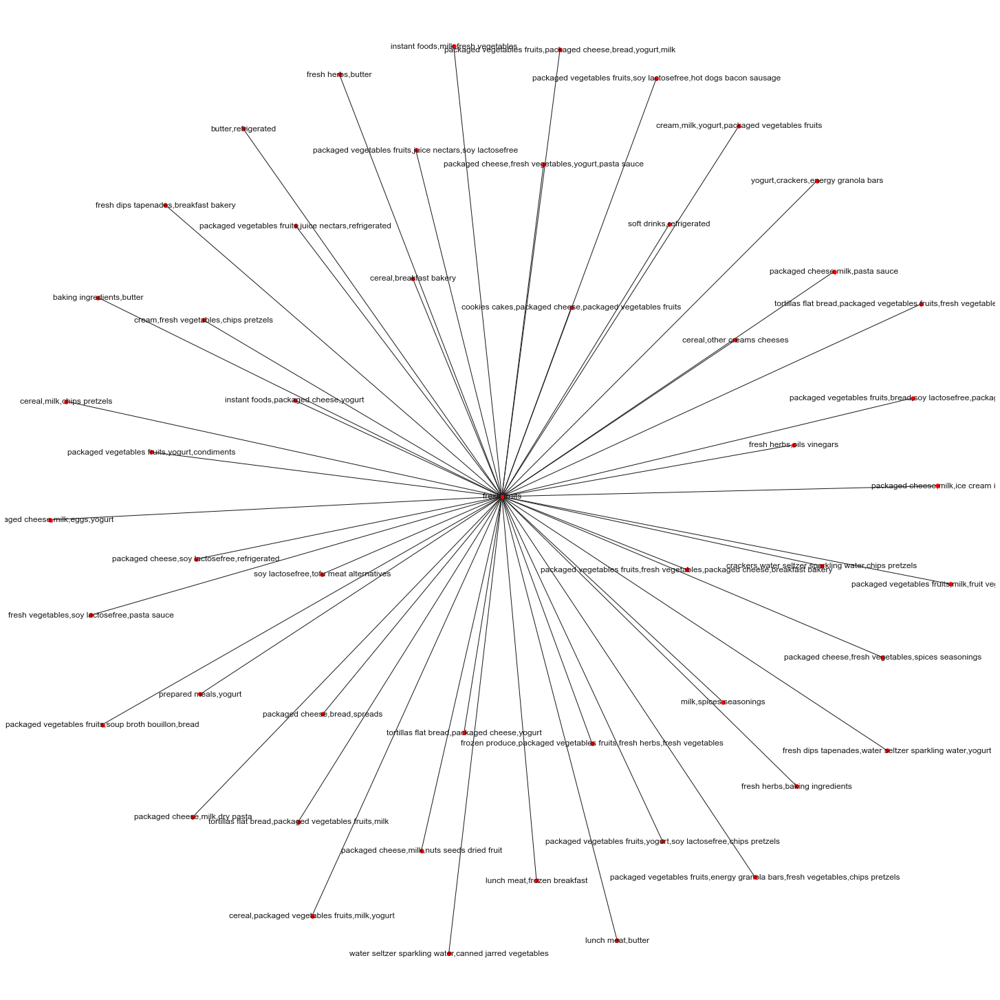

In [74]:
### Plot a basic network graph of the top 50 confidence rules
# Create a copy of the rules and transform the frozensets to strings
rulesToPlot = rulesConfidence.copy(deep=True)
rulesToPlot['LHS'] = [','.join(list(x)) for x in rulesToPlot['antecedents']]
rulesToPlot['RHS'] = [','.join(list(x)) for x in rulesToPlot['consequents']]
# Remove duplicate if reversed rules
rulesToPlot['sortedRow'] = [sorted([a,b]) for a,b in zip(rulesToPlot.LHS, rulesToPlot.RHS)]
rulesToPlot['sortedRow'] = rulesToPlot['sortedRow'].astype(str)
rulesToPlot.drop_duplicates(subset=['sortedRow'], inplace=True)
# Plot
rulesToPlot=rulesToPlot[:50]
fig = plt.figure(figsize=(20, 20)) 
G = nx.from_pandas_edgelist(rulesToPlot, 'LHS', 'RHS')  
# Each node is an itemset (either source or target) and the edges connect the itemsets if they consist of a high confidence rule
nx.draw(G, with_labels=True, node_size=30, node_color="red", pos=nx.spring_layout(G))
plt.axis('equal')
plt.show()
#fig.savefig('figure.svg')
# TRY TO PLOT THE DIRECTION OF SOURCE -> TARGET

### Cluster 2 - Sunday Weekly Purchasers 

In [75]:
comp_ord = cluster_2[['product_name', 'order_id']]
# Pivot the data - lines as orders and products as columns
pt = pd.pivot_table(comp_ord, index='order_id', columns='product_name', 
                    aggfunc=lambda x: 1 if len(x)>0 else 0).fillna(0)
pt

product_name,air fresheners candles,asian foods,baby accessories,baby bath body care,baby food formula,bakery desserts,baking ingredients,baking supplies decor,beauty,beers coolers,...,spreads,tea,tofu meat alternatives,tortillas flat bread,trail mix snack mix,trash bags liners,vitamins supplements,water seltzer sparkling water,white wines,yogurt
order_id,,,,,,,,,,,,,,,,,,,,,
56,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
140,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
147,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
527,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420240,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420610,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420861,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [76]:
# Apply the APRIORI algorithm to get frequent itemsets
# Rules supported in at least 5% of the transactions (more info at http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/apriori/)
frequent_itemsets = apriori(pt, min_support=0.01, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.050703,(asian foods)
1,0.056054,(baby food formula)
2,0.011324,(bakery desserts)
3,0.084459,(baking ingredients)
4,0.011378,(body lotions soap)
...,...,...
5013,0.010243,"(fresh fruits, fresh vegetables, packaged vege..."
5014,0.010811,"(fresh fruits, water seltzer sparkling water, ..."
5015,0.010351,"(fresh fruits, fresh vegetables, packaged vege..."
5016,0.013919,"(fresh fruits, fresh vegetables, packaged vege..."


In [77]:
# Generate the association rules - by confidence
rulesConfidence = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.00)
rulesConfidence.sort_values(by='lift', ascending=False, inplace=True)
rulesConfidence['rule'] = rulesConfidence['antecedents'].astype(str) + '-->' + rulesConfidence['consequents'].astype(str)  
rulesConfidence

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule
23613,"(fresh fruits, pasta sauce)","(packaged vegetables fruits, dry pasta)",0.057784,0.050405,0.012405,0.214687,4.259198,0.009493,1.209192,"frozenset({'fresh fruits', 'pasta sauce'})-->f..."
23612,"(packaged vegetables fruits, dry pasta)","(fresh fruits, pasta sauce)",0.050405,0.057784,0.012405,0.246113,4.259198,0.009493,1.249810,"frozenset({'packaged vegetables fruits', 'dry ..."
23766,"(packaged vegetables fruits, dry pasta)","(fresh vegetables, pasta sauce)",0.050405,0.055324,0.011811,0.234316,4.235322,0.009022,1.233768,"frozenset({'packaged vegetables fruits', 'dry ..."
23767,"(fresh vegetables, pasta sauce)","(packaged vegetables fruits, dry pasta)",0.055324,0.050405,0.011811,0.213483,4.235322,0.009022,1.207342,"frozenset({'fresh vegetables', 'pasta sauce'})..."
23611,"(packaged vegetables fruits, pasta sauce)","(fresh fruits, dry pasta)",0.044838,0.065757,0.012405,0.276673,4.207517,0.009457,1.291591,"frozenset({'packaged vegetables fruits', 'past..."
...,...,...,...,...,...,...,...,...,...,...
1080,(energy sports drinks),(fresh vegetables),0.025270,0.549892,0.010054,0.397861,0.723526,-0.003842,0.747515,frozenset({'energy sports drinks'})-->frozense...
9552,"(fresh fruits, fresh vegetables)",(soft drinks),0.409622,0.075622,0.022405,0.054698,0.723309,-0.008571,0.977865,"frozenset({'fresh fruits', 'fresh vegetables'}..."
9553,(soft drinks),"(fresh fruits, fresh vegetables)",0.075622,0.409622,0.022405,0.296283,0.723309,-0.008571,0.838943,frozenset({'soft drinks'})-->frozenset({'fresh...
28488,(soft drinks),"(packaged vegetables fruits, fresh fruits, fre...",0.075622,0.248838,0.013162,0.174053,0.699463,-0.005655,0.909456,frozenset({'soft drinks'})-->frozenset({'packa...


In [78]:
fig = go.Figure(data=go.Scatter(
    x = rulesConfidence['support'],
    y = rulesConfidence['confidence'],
    mode='markers',
    hovertext = rulesConfidence['rule'],
    marker=dict(
        size=16,
        color = rulesConfidence['lift'], #set color equal to a variable
        colorscale='OrRd', # one of plotly colorscales
        showscale=True, 
    )), 
    layout=go.Layout(
        xaxis=dict(autorange = True,
            title=dict(text="Support")),
        yaxis=dict(autorange = True, visible=True, showticklabels=True,
            title = dict(text="Confidence")),
        title=dict(text='Support, Confidence and Lift on Sunday Purchasers',
                   x=0.5, xanchor='center')))

fig.show()

In [79]:
# Generate the association rules - by lift
rulesLift = association_rules(frequent_itemsets, metric="lift", min_threshold=1.5)
rulesLift.sort_values(by='lift', ascending=False, inplace=True)
rulesLift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
9992,"(packaged vegetables fruits, dry pasta)","(fresh fruits, pasta sauce)",0.050405,0.057784,0.012405,0.246113,4.259198,0.009493,1.249810
9993,"(fresh fruits, pasta sauce)","(packaged vegetables fruits, dry pasta)",0.057784,0.050405,0.012405,0.214687,4.259198,0.009493,1.209192
10110,"(fresh vegetables, pasta sauce)","(packaged vegetables fruits, dry pasta)",0.055324,0.050405,0.011811,0.213483,4.235322,0.009022,1.207342
10109,"(packaged vegetables fruits, dry pasta)","(fresh vegetables, pasta sauce)",0.050405,0.055324,0.011811,0.234316,4.235322,0.009022,1.233768
9991,"(packaged vegetables fruits, pasta sauce)","(fresh fruits, dry pasta)",0.044838,0.065757,0.012405,0.276673,4.207517,0.009457,1.291591


In [80]:
# Add a column with the length
frequent_itemsets['length'] = frequent_itemsets['itemsets'].apply(lambda x: len(x))

# Length=2 and Support>=0.2
frequent_itemsets[(frequent_itemsets['length'] >= 2) & (frequent_itemsets['support'] >= 0.2)]

,support,itemsets,length
666,0.409622,"(fresh fruits, fresh vegetables)",2
689,0.200865,"(milk, fresh fruits)",2
695,0.201135,"(packaged cheese, fresh fruits)",2
698,0.338243,"(packaged vegetables fruits, fresh fruits)",2
720,0.239054,"(fresh fruits, yogurt)",2
773,0.305486,"(packaged vegetables fruits, fresh vegetables)",2
2380,0.248838,"(packaged vegetables fruits, fresh fruits, fre...",3


In [81]:
# High Confidence and high Lift - complementary products -> confidence above 0.7 and lift above 1.5
comp_placeholder = rulesConfidence.loc[(rulesConfidence['confidence'] >= 0.70) & (rulesConfidence['lift'] >= 1.5)]

comp_placeholder['Cluster'] = 2
comp_placeholder.sort_values(by = 'confidence', ascending = False, inplace = True)
comp_placeholder

<ipython-input-81-dfb649dcc3cb>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-81-dfb649dcc3cb>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
40050,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.014135,0.549892,0.013676,0.967495,1.759428,0.005903,13.847444,"frozenset({'packaged vegetables fruits', 'fres...",2
36959,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.013324,0.549892,0.012865,0.965517,1.755831,0.005538,13.053135,"frozenset({'packaged vegetables fruits', 'fres...",2
24712,"(packaged vegetables fruits, fresh herbs, eggs)",(fresh vegetables),0.015865,0.549892,0.015189,0.957411,1.741089,0.006465,10.568538,"frozenset({'packaged vegetables fruits', 'fres...",2
41759,"(soup broth bouillon, fresh herbs, fresh fruit...",(fresh vegetables),0.011405,0.549892,0.010919,0.957346,1.740971,0.004647,10.552535,"frozenset({'soup broth bouillon', 'fresh herbs...",2
42481,"(packaged vegetables fruits, fruit vegetable s...",(fresh fruits),0.011162,0.635189,0.010676,0.956416,1.505719,0.003586,8.370381,"frozenset({'packaged vegetables fruits', 'frui...",2
...,...,...,...,...,...,...,...,...,...,...,...
37260,"(milk, canned meals beans, fresh fruits, fresh...",(packaged vegetables fruits),0.019027,0.443432,0.013324,0.700284,1.579235,0.004887,1.856984,"frozenset({'milk', 'canned meals beans', 'fres...",2
47353,"(packaged vegetables fruits, milk, crackers, y...","(fresh fruits, fresh vegetables)",0.015324,0.409622,0.010730,0.700176,1.709325,0.004453,1.969086,"frozenset({'packaged vegetables fruits', 'milk...",2
46672,"(packaged vegetables fruits, eggs, yogurt, bread)","(fresh fruits, fresh vegetables)",0.015324,0.409622,0.010730,0.700176,1.709325,0.004453,1.969086,"frozenset({'packaged vegetables fruits', 'eggs...",2
42462,"(frozen produce, soy lactosefree, yogurt)","(fresh fruits, fresh vegetables)",0.018108,0.409622,0.012676,0.700000,1.708894,0.005258,1.967928,"frozenset({'frozen produce', 'soy lactosefree'...",2


In [82]:
#join complementary items
frames = [complementary, comp_placeholder]
complementary = pd.concat(frames)
complementary

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
3555,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.012614,0.309213,0.011410,0.904570,2.925394,0.007510,7.238670,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",0
3540,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.023940,0.309213,0.021600,0.902266,2.917944,0.014197,7.068053,"frozenset({'packaged vegetables fruits', 'fres...",0
4482,"(packaged vegetables fruits, soy lactosefree, ...",(fresh fruits),0.012021,0.416805,0.010766,0.895628,2.148792,0.005756,5.587637,"frozenset({'packaged vegetables fruits', 'soy ...",0
3526,"(packaged cheese, fresh herbs, fresh fruits)",(fresh vegetables),0.011732,0.309213,0.010461,0.891618,2.883509,0.006833,6.373662,"frozenset({'packaged cheese', 'fresh herbs', '...",0
4302,"(packaged vegetables fruits, bread, fresh vege...",(fresh fruits),0.012444,0.416805,0.011003,0.884196,2.121366,0.005816,5.036059,"frozenset({'packaged vegetables fruits', 'brea...",0
...,...,...,...,...,...,...,...,...,...,...,...
37260,"(milk, canned meals beans, fresh fruits, fresh...",(packaged vegetables fruits),0.019027,0.443432,0.013324,0.700284,1.579235,0.004887,1.856984,"frozenset({'milk', 'canned meals beans', 'fres...",2
47353,"(packaged vegetables fruits, milk, crackers, y...","(fresh fruits, fresh vegetables)",0.015324,0.409622,0.010730,0.700176,1.709325,0.004453,1.969086,"frozenset({'packaged vegetables fruits', 'milk...",2
46672,"(packaged vegetables fruits, eggs, yogurt, bread)","(fresh fruits, fresh vegetables)",0.015324,0.409622,0.010730,0.700176,1.709325,0.004453,1.969086,"frozenset({'packaged vegetables fruits', 'eggs...",2
42462,"(frozen produce, soy lactosefree, yogurt)","(fresh fruits, fresh vegetables)",0.018108,0.409622,0.012676,0.700000,1.708894,0.005258,1.967928,"frozenset({'frozen produce', 'soy lactosefree'...",2


In [83]:
# Substitute products , lift < 1
rulesLift2 = association_rules(frequent_itemsets, metric="lift", min_threshold=0.0)
rulesLift2.sort_values(by='lift', ascending=True, inplace=True)
rulesLift2 = rulesLift2[rulesLift2['lift'] < 1]
rulesLift2['rule'] = rulesLift2['antecedents'].astype(str) + '-->' + rulesLift2['consequents'].astype(str) 
rulesLift2['Cluster'] = 2

rulesLift2

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
28481,"(packaged vegetables fruits, fresh fruits, fre...",(soft drinks),0.248838,0.075622,0.013162,0.052895,0.699463,-0.005655,0.976004,"frozenset({'packaged vegetables fruits', 'fres...",2
28488,(soft drinks),"(packaged vegetables fruits, fresh fruits, fre...",0.075622,0.248838,0.013162,0.174053,0.699463,-0.005655,0.909456,frozenset({'soft drinks'})-->frozenset({'packa...,2
9553,(soft drinks),"(fresh fruits, fresh vegetables)",0.075622,0.409622,0.022405,0.296283,0.723309,-0.008571,0.838943,frozenset({'soft drinks'})-->frozenset({'fresh...,2
9552,"(fresh fruits, fresh vegetables)",(soft drinks),0.409622,0.075622,0.022405,0.054698,0.723309,-0.008571,0.977865,"frozenset({'fresh fruits', 'fresh vegetables'}...",2
1080,(energy sports drinks),(fresh vegetables),0.025270,0.549892,0.010054,0.397861,0.723526,-0.003842,0.747515,frozenset({'energy sports drinks'})-->frozense...,2
...,...,...,...,...,...,...,...,...,...,...,...
1803,(packaged poultry),(milk),0.049027,0.277405,0.013568,0.276736,0.997589,-0.000033,0.999075,frozenset({'packaged poultry'})-->frozenset({'...,2
5121,(water seltzer sparkling water),"(canned meals beans, fresh vegetables)",0.200459,0.072838,0.014568,0.072671,0.997708,-0.000033,0.999820,frozenset({'water seltzer sparkling water'})--...,2
5116,"(canned meals beans, fresh vegetables)",(water seltzer sparkling water),0.072838,0.200459,0.014568,0.200000,0.997708,-0.000033,0.999426,"frozenset({'canned meals beans', 'fresh vegeta...",2
752,(cookies cakes),(packaged vegetables fruits),0.058162,0.443432,0.025784,0.443309,0.999721,-0.000007,0.999777,frozenset({'cookies cakes'})-->frozenset({'pac...,2


In [84]:
to_concat = [substitutes, rulesLift2]

substitutes = pd.concat(to_concat)
substitutes

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1938,"(fresh fruits, fresh vegetables)",(soft drinks),0.201197,0.086772,0.011020,0.054774,0.631236,-0.006438,0.966147,"frozenset({'fresh fruits', 'fresh vegetables'}...",0
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...,0
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...,0
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...,0
752,(packaged vegetables fruits),(soft drinks),0.258825,0.086772,0.015445,0.059675,0.687721,-0.007013,0.971183,frozenset({'packaged vegetables fruits'})-->fr...,0
...,...,...,...,...,...,...,...,...,...,...,...
1803,(packaged poultry),(milk),0.049027,0.277405,0.013568,0.276736,0.997589,-0.000033,0.999075,frozenset({'packaged poultry'})-->frozenset({'...,2
5121,(water seltzer sparkling water),"(canned meals beans, fresh vegetables)",0.200459,0.072838,0.014568,0.072671,0.997708,-0.000033,0.999820,frozenset({'water seltzer sparkling water'})--...,2
5116,"(canned meals beans, fresh vegetables)",(water seltzer sparkling water),0.072838,0.200459,0.014568,0.200000,0.997708,-0.000033,0.999426,"frozenset({'canned meals beans', 'fresh vegeta...",2
752,(cookies cakes),(packaged vegetables fruits),0.058162,0.443432,0.025784,0.443309,0.999721,-0.000007,0.999777,frozenset({'cookies cakes'})-->frozenset({'pac...,2


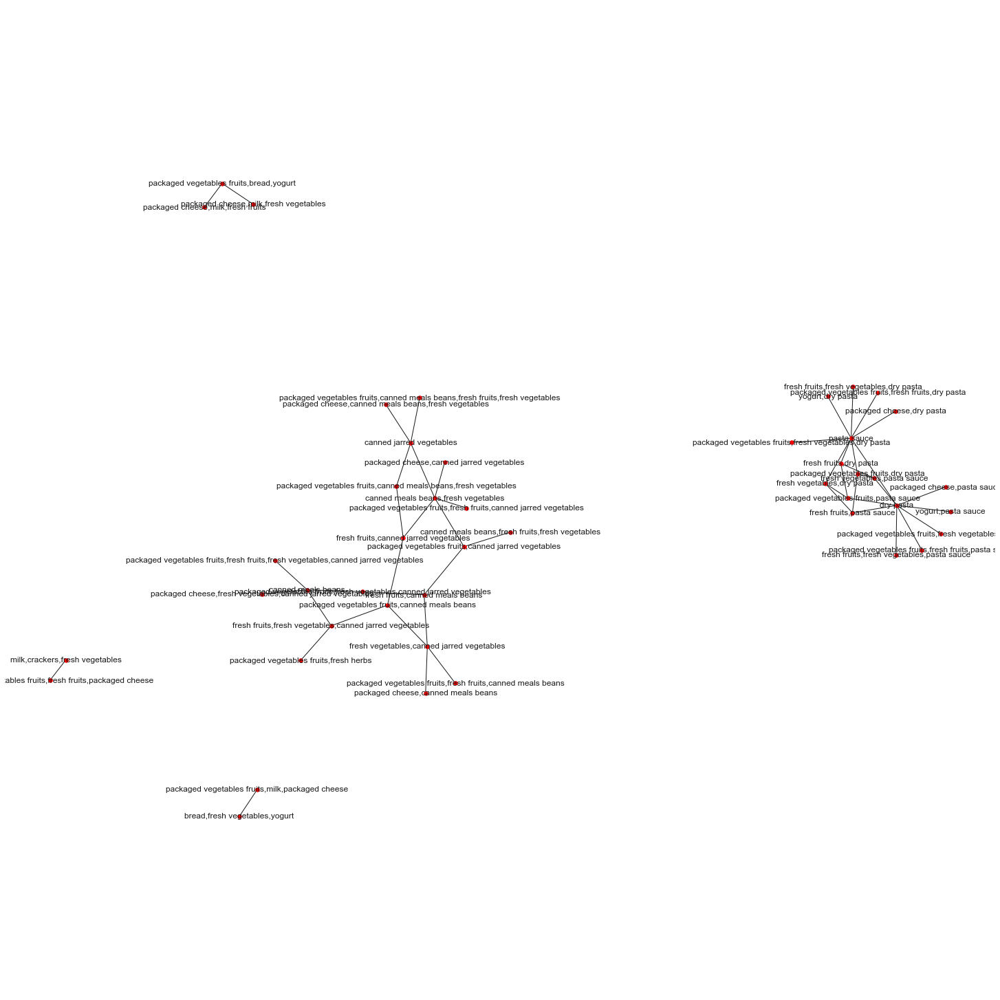

In [85]:
### Plot a basic network graph of the top 50 confidence rules
# Create a copy of the rules and transform the frozensets to strings
rulesToPlot = rulesConfidence.copy(deep=True)
rulesToPlot['LHS'] = [','.join(list(x)) for x in rulesToPlot['antecedents']]
rulesToPlot['RHS'] = [','.join(list(x)) for x in rulesToPlot['consequents']]
# Remove duplicate if reversed rules
rulesToPlot['sortedRow'] = [sorted([a,b]) for a,b in zip(rulesToPlot.LHS, rulesToPlot.RHS)]
rulesToPlot['sortedRow'] = rulesToPlot['sortedRow'].astype(str)
rulesToPlot.drop_duplicates(subset=['sortedRow'], inplace=True)
# Plot
rulesToPlot=rulesToPlot[:50]
fig = plt.figure(figsize=(20, 20)) 
G = nx.from_pandas_edgelist(rulesToPlot, 'LHS', 'RHS')  
# Each node is an itemset (either source or target) and the edges connect the itemsets if they consist of a high confidence rule
nx.draw(G, with_labels=True, node_size=30, node_color="red", pos=nx.spring_layout(G))
plt.axis('equal')
plt.show()
#fig.savefig('figure.svg')
# TRY TO PLOT THE DIRECTION OF SOURCE -> TARGET

### Cluster 3 - Saturday Weekly Purchasers

In [86]:
comp_ord = cluster_3[['product_name', 'order_id']]
# Pivot the data - lines as orders and products as columns
pt = pd.pivot_table(comp_ord, index='order_id', columns='product_name', 
                    aggfunc=lambda x: 1 if len(x)>0 else 0).fillna(0)
pt

product_name,air fresheners candles,asian foods,baby accessories,baby bath body care,baby food formula,bakery desserts,baking ingredients,baking supplies decor,beauty,beers coolers,...,spreads,tea,tofu meat alternatives,tortillas flat bread,trail mix snack mix,trash bags liners,vitamins supplements,water seltzer sparkling water,white wines,yogurt
order_id,,,,,,,,,,,,,,,,,,,,,
10,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
38,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
227,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
399,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
405,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420584,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420760,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3420771,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [87]:
# Apply the APRIORI algorithm to get frequent itemsets
# Rules supported in at least 5% of the transactions (more info at http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/apriori/)
frequent_itemsets = apriori(pt, min_support=0.03, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.052668,(asian foods)
1,0.050092,(baby food formula)
2,0.092060,(baking ingredients)
3,0.190177,(bread)
4,0.073488,(breakfast bakery)
...,...,...
568,0.049512,"(packaged vegetables fruits, yogurt, fresh veg..."
569,0.030650,"(packaged vegetables fruits, soy lactosefree, ..."
570,0.035801,"(fresh fruits, fresh vegetables, packaged vege..."
571,0.040480,"(fresh fruits, fresh vegetables, packaged vege..."


In [88]:
# Generate the association rules - by confidence
rulesConfidence = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.00)
rulesConfidence.sort_values(by='lift', ascending=False, inplace=True)
rulesConfidence['rule'] = rulesConfidence['antecedents'].astype(str) + '-->' + rulesConfidence['consequents'].astype(str)  
rulesConfidence

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule
2523,"(packaged vegetables fruits, yogurt)","(packaged cheese, fresh fruits, fresh vegetables)",0.152200,0.129348,0.043817,0.287893,2.225723,0.024131,1.222642,"frozenset({'packaged vegetables fruits', 'yogu..."
2506,"(packaged cheese, fresh fruits, fresh vegetables)","(packaged vegetables fruits, yogurt)",0.129348,0.152200,0.043817,0.338755,2.225723,0.024131,1.282127,"frozenset({'packaged cheese', 'fresh fruits', ..."
2477,"(milk, fresh fruits, fresh vegetables)","(packaged vegetables fruits, yogurt)",0.120353,0.152200,0.040480,0.336347,2.209904,0.022163,1.277475,"frozenset({'milk', 'fresh fruits', 'fresh vege..."
2492,"(packaged vegetables fruits, yogurt)","(milk, fresh fruits, fresh vegetables)",0.152200,0.120353,0.040480,0.265968,2.209904,0.022163,1.198377,"frozenset({'packaged vegetables fruits', 'yogu..."
2446,"(packaged cheese, fresh fruits, fresh vegetables)","(packaged vegetables fruits, milk)",0.129348,0.125721,0.035801,0.276781,2.201549,0.019539,1.208871,"frozenset({'packaged cheese', 'fresh fruits', ..."
...,...,...,...,...,...,...,...,...,...,...
468,(packaged vegetables fruits),(soft drinks),0.414378,0.091625,0.031702,0.076506,0.834989,-0.006265,0.983628,frozenset({'packaged vegetables fruits'})-->fr...
430,(milk),(soy lactosefree),0.261743,0.194312,0.040226,0.153686,0.790923,-0.010634,0.951996,frozenset({'milk'})-->frozenset({'soy lactosef...
431,(soy lactosefree),(milk),0.194312,0.261743,0.040226,0.207019,0.790923,-0.010634,0.930989,frozenset({'soy lactosefree'})-->frozenset({'m...
344,(soft drinks),(fresh vegetables),0.091625,0.529580,0.038340,0.418448,0.790150,-0.010182,0.808904,frozenset({'soft drinks'})-->frozenset({'fresh...


In [89]:
fig = go.Figure(data=go.Scatter(
    x = rulesConfidence['support'],
    y = rulesConfidence['confidence'],
    mode='markers',
    hovertext = rulesConfidence['rule'],
    marker=dict(
        size=16,
        color = rulesConfidence['lift'], #set color equal to a variable
        colorscale='OrRd', # one of plotly colorscales
        showscale=True, 
    )), 
    layout=go.Layout(
        xaxis=dict(autorange = True,
            title=dict(text="Support")),
        yaxis=dict(autorange = True, visible=True, showticklabels=True,
            title = dict(text="Confidence")),
        title=dict(text='Support, Confidence and Lift on Saturday Purchasers',
                   x=0.5, xanchor='center')))

fig.show()

In [90]:
# Generate the association rules - by lift
rulesLift = association_rules(frequent_itemsets, metric="lift", min_threshold=1.5)
rulesLift.sort_values(by='lift', ascending=False, inplace=True)
rulesLift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
717,"(packaged vegetables fruits, yogurt)","(packaged cheese, fresh fruits, fresh vegetables)",0.152200,0.129348,0.043817,0.287893,2.225723,0.024131,1.222642
700,"(packaged cheese, fresh fruits, fresh vegetables)","(packaged vegetables fruits, yogurt)",0.129348,0.152200,0.043817,0.338755,2.225723,0.024131,1.282127
690,"(packaged vegetables fruits, yogurt)","(milk, fresh fruits, fresh vegetables)",0.152200,0.120353,0.040480,0.265968,2.209904,0.022163,1.198377
675,"(milk, fresh fruits, fresh vegetables)","(packaged vegetables fruits, yogurt)",0.120353,0.152200,0.040480,0.336347,2.209904,0.022163,1.277475
648,"(packaged cheese, fresh fruits, fresh vegetables)","(packaged vegetables fruits, milk)",0.129348,0.125721,0.035801,0.276781,2.201549,0.019539,1.208871


In [91]:
# Add a column with the length
frequent_itemsets['length'] = frequent_itemsets['itemsets'].apply(lambda x: len(x))

# Length=2 and Support>=0.2
frequent_itemsets[(frequent_itemsets['length'] >= 2) & (frequent_itemsets['support'] >= 0.2)]

,support,itemsets,length
177,0.381407,"(fresh fruits, fresh vegetables)",2
198,0.309442,"(packaged vegetables fruits, fresh fruits)",2
212,0.219087,"(fresh fruits, yogurt)",2
235,0.283724,"(packaged vegetables fruits, fresh vegetables)",2
420,0.226740,"(packaged vegetables fruits, fresh fruits, fre...",3


In [92]:
# High Confidence and high Lift - complementary products -> confidence above 0.7 and lift above 1.5
comp_placeholder = rulesConfidence.loc[(rulesConfidence['confidence'] >= 0.70) & (rulesConfidence['lift'] >= 1.5)]

comp_placeholder['Cluster'] = 3
comp_placeholder.sort_values(by = 'confidence', ascending = False, inplace = True)
comp_placeholder

<ipython-input-92-9029c9328036>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-92-9029c9328036>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1992,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.056223,0.529580,0.051507,0.916129,1.729915,0.021733,5.608850,"frozenset({'packaged vegetables fruits', 'fres...",3
2007,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.034749,0.529580,0.031557,0.908142,1.714833,0.013155,5.121160,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",3
1420,"(packaged vegetables fruits, fresh herbs)",(fresh vegetables),0.067794,0.529580,0.060974,0.899411,1.698348,0.025072,4.676672,"frozenset({'packaged vegetables fruits', 'fres...",3
1012,"(fresh herbs, fresh fruits)",(fresh vegetables),0.091081,0.529580,0.081178,0.891278,1.682990,0.032944,4.326827,"frozenset({'fresh herbs', 'fresh fruits'})-->f...",3
1427,"(fresh herbs, yogurt)",(fresh vegetables),0.041351,0.529580,0.036853,0.891228,1.682895,0.014954,4.324826,"frozenset({'fresh herbs', 'yogurt'})-->frozens...",3
1409,"(milk, fresh herbs)",(fresh vegetables),0.034205,0.529580,0.030469,0.890774,1.682038,0.012355,4.306852,"frozenset({'milk', 'fresh herbs'})-->frozenset...",3
1797,"(packaged vegetables fruits, fresh fruits, can...",(fresh vegetables),0.037397,0.529580,0.032863,0.878758,1.659349,0.013058,3.880021,"frozenset({'packaged vegetables fruits', 'fres...",3
1414,"(packaged cheese, fresh herbs)",(fresh vegetables),0.041387,0.529580,0.036091,0.872042,1.646666,0.014173,3.676362,"frozenset({'packaged cheese', 'fresh herbs'})-...",3
1810,"(packaged vegetables fruits, fresh fruits, can...",(fresh vegetables),0.039537,0.529580,0.034169,0.864220,1.631896,0.013231,3.464577,"frozenset({'packaged vegetables fruits', 'fres...",3
290,(fresh herbs),(fresh vegetables),0.119881,0.529580,0.102434,0.854463,1.613472,0.038947,3.232302,frozenset({'fresh herbs'})-->frozenset({'fresh...,3


In [93]:
#join complementary items
frames = [complementary, comp_placeholder]
complementary = pd.concat(frames)
complementary

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
3555,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.012614,0.309213,0.011410,0.904570,2.925394,0.007510,7.238670,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",0
3540,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.023940,0.309213,0.021600,0.902266,2.917944,0.014197,7.068053,"frozenset({'packaged vegetables fruits', 'fres...",0
4482,"(packaged vegetables fruits, soy lactosefree, ...",(fresh fruits),0.012021,0.416805,0.010766,0.895628,2.148792,0.005756,5.587637,"frozenset({'packaged vegetables fruits', 'soy ...",0
3526,"(packaged cheese, fresh herbs, fresh fruits)",(fresh vegetables),0.011732,0.309213,0.010461,0.891618,2.883509,0.006833,6.373662,"frozenset({'packaged cheese', 'fresh herbs', '...",0
4302,"(packaged vegetables fruits, bread, fresh vege...",(fresh fruits),0.012444,0.416805,0.011003,0.884196,2.121366,0.005816,5.036059,"frozenset({'packaged vegetables fruits', 'brea...",0
...,...,...,...,...,...,...,...,...,...,...,...
1582,"(packaged vegetables fruits, soup broth bouillon)",(fresh vegetables),0.054554,0.529580,0.043527,0.797872,1.506613,0.014636,2.327339,"frozenset({'packaged vegetables fruits', 'soup...",3
2012,"(fresh herbs, yogurt)","(fresh fruits, fresh vegetables)",0.041351,0.381407,0.031557,0.763158,2.000903,0.015786,2.611839,"frozenset({'fresh herbs', 'yogurt'})-->frozens...",3
1996,"(packaged vegetables fruits, fresh herbs)","(fresh fruits, fresh vegetables)",0.067794,0.381407,0.051507,0.759765,1.992007,0.025650,2.574946,"frozenset({'packaged vegetables fruits', 'fres...",3
1814,"(packaged vegetables fruits, canned meals beans)","(fresh fruits, fresh vegetables)",0.047553,0.381407,0.034169,0.718535,1.883909,0.016032,2.197767,"frozenset({'packaged vegetables fruits', 'cann...",3


In [94]:
# Substitute products , lift < 1
rulesLift2 = association_rules(frequent_itemsets, metric="lift", min_threshold=0.0)
rulesLift2.sort_values(by='lift', ascending=True, inplace=True)
rulesLift2 = rulesLift2[rulesLift2['lift'] < 1]
rulesLift2['rule'] = rulesLift2['antecedents'].astype(str) + '-->' + rulesLift2['consequents'].astype(str) 
rulesLift2['Cluster'] = 3

rulesLift2

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
345,(fresh vegetables),(soft drinks),0.529580,0.091625,0.038340,0.072397,0.790150,-0.010182,0.979272,frozenset({'fresh vegetables'})-->frozenset({'...,3
344,(soft drinks),(fresh vegetables),0.091625,0.529580,0.038340,0.418448,0.790150,-0.010182,0.808904,frozenset({'soft drinks'})-->frozenset({'fresh...,3
431,(soy lactosefree),(milk),0.194312,0.261743,0.040226,0.207019,0.790923,-0.010634,0.930989,frozenset({'soy lactosefree'})-->frozenset({'m...,3
430,(milk),(soy lactosefree),0.261743,0.194312,0.040226,0.153686,0.790923,-0.010634,0.951996,frozenset({'milk'})-->frozenset({'soy lactosef...,3
468,(packaged vegetables fruits),(soft drinks),0.414378,0.091625,0.031702,0.076506,0.834989,-0.006265,0.983628,frozenset({'packaged vegetables fruits'})-->fr...,3
469,(soft drinks),(packaged vegetables fruits),0.091625,0.414378,0.031702,0.346002,0.834989,-0.006265,0.895448,frozenset({'soft drinks'})-->frozenset({'packa...,3
272,(soft drinks),(fresh fruits),0.091625,0.605281,0.046574,0.508314,0.839797,-0.008885,0.802785,frozenset({'soft drinks'})-->frozenset({'fresh...,3
273,(fresh fruits),(soft drinks),0.605281,0.091625,0.046574,0.076946,0.839797,-0.008885,0.984098,frozenset({'fresh fruits'})-->frozenset({'soft...,3
336,(fresh vegetables),(paper goods),0.529580,0.072219,0.032718,0.061781,0.855467,-0.005528,0.988875,frozenset({'fresh vegetables'})-->frozenset({'...,3
337,(paper goods),(fresh vegetables),0.072219,0.529580,0.032718,0.453039,0.855467,-0.005528,0.860060,frozenset({'paper goods'})-->frozenset({'fresh...,3


In [95]:
to_concat = [substitutes, rulesLift2]

substitutes = pd.concat(to_concat)
substitutes

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1938,"(fresh fruits, fresh vegetables)",(soft drinks),0.201197,0.086772,0.011020,0.054774,0.631236,-0.006438,0.966147,"frozenset({'fresh fruits', 'fresh vegetables'}...",0
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...,0
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...,0
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...,0
752,(packaged vegetables fruits),(soft drinks),0.258825,0.086772,0.015445,0.059675,0.687721,-0.007013,0.971183,frozenset({'packaged vegetables fruits'})-->fr...,0
...,...,...,...,...,...,...,...,...,...,...,...
133,(coffee),(fresh fruits),0.057202,0.605281,0.034278,0.599239,0.990017,-0.000346,0.984923,frozenset({'coffee'})-->frozenset({'fresh frui...,3
239,(fresh fruits),(ice cream ice),0.605281,0.142298,0.085821,0.141787,0.996413,-0.000309,0.999405,frozenset({'fresh fruits'})-->frozenset({'ice ...,3
238,(ice cream ice),(fresh fruits),0.142298,0.605281,0.085821,0.603110,0.996413,-0.000309,0.994529,frozenset({'ice cream ice'})-->frozenset({'fre...,3
224,(fresh fruits),(frozen meals),0.605281,0.091661,0.055316,0.091389,0.997028,-0.000165,0.999700,frozenset({'fresh fruits'})-->frozenset({'froz...,3


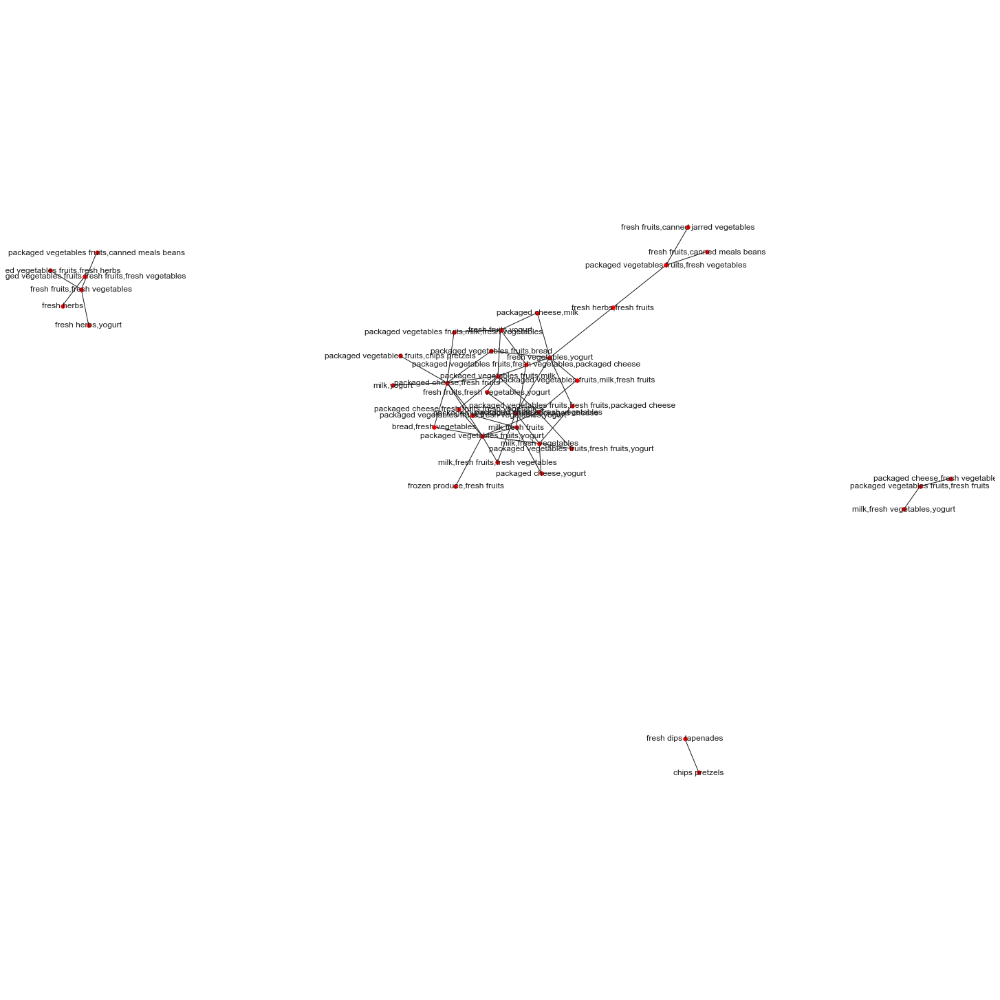

In [96]:
### Plot a basic network graph of the top 50 confidence rules
# Create a copy of the rules and transform the frozensets to strings
rulesToPlot = rulesConfidence.copy(deep=True)
rulesToPlot['LHS'] = [','.join(list(x)) for x in rulesToPlot['antecedents']]
rulesToPlot['RHS'] = [','.join(list(x)) for x in rulesToPlot['consequents']]
# Remove duplicate if reversed rules
rulesToPlot['sortedRow'] = [sorted([a,b]) for a,b in zip(rulesToPlot.LHS, rulesToPlot.RHS)]
rulesToPlot['sortedRow'] = rulesToPlot['sortedRow'].astype(str)
rulesToPlot.drop_duplicates(subset=['sortedRow'], inplace=True)
# Plot
rulesToPlot=rulesToPlot[:50]
fig = plt.figure(figsize=(20, 20)) 
G = nx.from_pandas_edgelist(rulesToPlot, 'LHS', 'RHS')  
# Each node is an itemset (either source or target) and the edges connect the itemsets if they consist of a high confidence rule
nx.draw(G, with_labels=True, node_size=30, node_color="red", pos=nx.spring_layout(G))
plt.axis('equal')
plt.show()
#fig.savefig('figure.svg')
# TRY TO PLOT THE DIRECTION OF SOURCE -> TARGET

#### Cluster 4 - Friday Buyers

In [97]:
comp_ord = cluster_4[['product_name', 'order_id']]
# Pivot the data - lines as orders and products as columns
pt = pd.pivot_table(comp_ord, index='order_id', columns='product_name', 
                    aggfunc=lambda x: 1 if len(x)>0 else 0).fillna(0)
pt

product_name,air fresheners candles,asian foods,baby accessories,baby bath body care,baby food formula,bakery desserts,baking ingredients,baking supplies decor,beauty,beers coolers,...,spreads,tea,tofu meat alternatives,tortillas flat bread,trail mix snack mix,trash bags liners,vitamins supplements,water seltzer sparkling water,white wines,yogurt
order_id,,,,,,,,,,,,,,,,,,,,,
122,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
192,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
207,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
285,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
372,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420503,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420542,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
3420578,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [98]:
# Apply the APRIORI algorithm to get frequent itemsets
# Rules supported in at least 5% of the transactions (more info at http://rasbt.github.io/mlxtend/user_guide/frequent_patterns/apriori/)
frequent_itemsets = apriori(pt, min_support=0.01, use_colnames=True)
frequent_itemsets

,support,itemsets
0,0.045954,(asian foods)
1,0.052331,(baby food formula)
2,0.011669,(bakery desserts)
3,0.090527,(baking ingredients)
4,0.187890,(bread)
...,...,...
3699,0.010289,"(fresh fruits, fresh vegetables, packaged vege..."
3700,0.010223,"(fresh fruits, fresh vegetables, frozen produc..."
3701,0.010880,"(fresh fruits, lunch meat, fresh vegetables, p..."
3702,0.018671,"(fresh fruits, fresh vegetables, packaged vege..."


In [99]:
# Generate the association rules - by confidence
rulesConfidence = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.00)
rulesConfidence.sort_values(by='confidence', ascending=False, inplace=True)
rulesConfidence['rule'] = rulesConfidence['antecedents'].astype(str) + '-->' + rulesConfidence['consequents'].astype(str)  
rulesConfidence

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule
29302,"(packaged vegetables fruits, milk, soy lactose...",(fresh fruits),0.013477,0.607751,0.012754,0.946341,1.557120,0.004563,7.310096,"frozenset({'packaged vegetables fruits', 'milk..."
29787,"(fresh vegetables, packaged vegetables fruits,...",(fresh fruits),0.014628,0.607751,0.013773,0.941573,1.549274,0.004883,6.713493,"frozenset({'fresh vegetables', 'packaged veget..."
23422,"(packaged vegetables fruits, fresh vegetables,...",(fresh fruits),0.010650,0.607751,0.010026,0.941358,1.548921,0.003553,6.688878,"frozenset({'packaged vegetables fruits', 'fres..."
26990,"(frozen produce, packaged vegetables fruits, f...",(fresh vegetables),0.011669,0.469430,0.010946,0.938028,1.998228,0.005468,8.561470,"frozenset({'frozen produce', 'packaged vegetab..."
30159,"(lunch meat, fresh vegetables, packaged vegeta...",(fresh fruits),0.011603,0.607751,0.010880,0.937677,1.542864,0.003828,6.293814,"frozenset({'lunch meat', 'fresh vegetables', '..."
...,...,...,...,...,...,...,...,...,...,...
13544,(fresh fruits),"(fresh vegetables, chips pretzels, butter)",0.607751,0.011899,0.010026,0.016496,1.386327,0.002794,1.004674,frozenset({'fresh fruits'})-->frozenset({'fres...
12635,(fresh fruits),"(ice cream ice, bread, yogurt)",0.607751,0.012162,0.010026,0.016496,1.356352,0.002634,1.004407,frozenset({'fresh fruits'})-->frozenset({'ice ...
23443,(fresh fruits),"(packaged vegetables fruits, fresh vegetables,...",0.607751,0.010650,0.010026,0.016496,1.548921,0.003553,1.005944,frozenset({'fresh fruits'})-->frozenset({'pack...
21176,(fresh fruits),"(packaged cheese, milk, spreads)",0.607751,0.011636,0.010026,0.016496,1.417656,0.002954,1.004941,frozenset({'fresh fruits'})-->frozenset({'pack...


In [100]:
fig = go.Figure(data=go.Scatter(
    x = rulesConfidence['support'],
    y = rulesConfidence['confidence'],
    mode='markers',
    hovertext = rulesConfidence['rule'],
    marker=dict(
        size=16,
        color = rulesConfidence['lift'], #set color equal to a variable
        colorscale='OrRd', # one of plotly colorscales
        showscale=True, 
    )), 
    layout=go.Layout(
        xaxis=dict(autorange = True,
            title=dict(text="Support")),
        yaxis=dict(autorange = True, visible=True, showticklabels=True,
            title = dict(text="Confidence")),
        title=dict(text='Support, Confidence and Lift on Saturday Purchasers',
                   x=0.5, xanchor='center')))

fig.show()

In [101]:
# Generate the association rules - by lift
rulesLift = association_rules(frequent_itemsets, metric="lift", min_threshold=1.5)
rulesLift.sort_values(by='lift', ascending=False, inplace=True)
rulesLift.head()

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
7582,"(fresh vegetables, pasta sauce)","(fresh fruits, dry pasta)",0.042502,0.051870,0.010387,0.244393,4.711610,0.008183,1.254792
7581,"(fresh fruits, dry pasta)","(fresh vegetables, pasta sauce)",0.051870,0.042502,0.010387,0.200253,4.711610,0.008183,1.197252
7580,"(fresh fruits, pasta sauce)","(fresh vegetables, dry pasta)",0.044343,0.050128,0.010387,0.234248,4.672971,0.008164,1.240442
7583,"(fresh vegetables, dry pasta)","(fresh fruits, pasta sauce)",0.050128,0.044343,0.010387,0.207213,4.672971,0.008164,1.205440
2217,"(packaged vegetables fruits, dry pasta)",(pasta sauce),0.037440,0.064361,0.010584,0.282704,4.392454,0.008175,1.304397


In [102]:
# Add a column with the length
frequent_itemsets['length'] = frequent_itemsets['itemsets'].apply(lambda x: len(x))

# Length=2 and Support>=0.2
frequent_itemsets[(frequent_itemsets['length'] >= 2) & (frequent_itemsets['support'] >= 0.2)]

,support,itemsets,length
627,0.340576,"(fresh fruits, fresh vegetables)",2
659,0.291927,"(packaged vegetables fruits, fresh fruits)",2
681,0.214976,"(fresh fruits, yogurt)",2
728,0.246499,"(packaged vegetables fruits, fresh vegetables)",2


In [103]:
# High Confidence and high Lift - complementary products -> confidence above 0.7 and lift above 1.5
comp_placeholder = rulesConfidence.loc[(rulesConfidence['confidence'] >= 0.70) & (rulesConfidence['lift'] >= 1.5)]

comp_placeholder['Cluster'] = 4
comp_placeholder.sort_values(by = 'confidence', ascending = False, inplace = True)
comp_placeholder

<ipython-input-103-7b520eca76fa>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-103-7b520eca76fa>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
29302,"(packaged vegetables fruits, milk, soy lactose...",(fresh fruits),0.013477,0.607751,0.012754,0.946341,1.557120,0.004563,7.310096,"frozenset({'packaged vegetables fruits', 'milk...",4
29787,"(fresh vegetables, packaged vegetables fruits,...",(fresh fruits),0.014628,0.607751,0.013773,0.941573,1.549274,0.004883,6.713493,"frozenset({'fresh vegetables', 'packaged veget...",4
23422,"(packaged vegetables fruits, fresh vegetables,...",(fresh fruits),0.010650,0.607751,0.010026,0.941358,1.548921,0.003553,6.688878,"frozenset({'packaged vegetables fruits', 'fres...",4
26990,"(frozen produce, packaged vegetables fruits, f...",(fresh vegetables),0.011669,0.469430,0.010946,0.938028,1.998228,0.005468,8.561470,"frozenset({'frozen produce', 'packaged vegetab...",4
30159,"(lunch meat, fresh vegetables, packaged vegeta...",(fresh fruits),0.011603,0.607751,0.010880,0.937677,1.542864,0.003828,6.293814,"frozenset({'lunch meat', 'fresh vegetables', '...",4
...,...,...,...,...,...,...,...,...,...,...,...
11605,"(fresh fruits, canned meals beans, bread)",(packaged vegetables fruits),0.014529,0.389488,0.010190,0.701357,1.800717,0.004531,2.044291,"frozenset({'fresh fruits', 'canned meals beans...",4
22469,"(lunch meat, fresh vegetables, yogurt)",(packaged vegetables fruits),0.027250,0.389488,0.019098,0.700844,1.799400,0.008484,2.040784,"frozenset({'lunch meat', 'fresh vegetables', '...",4
18227,"(fresh dips tapenades, fresh vegetables, yogurt)",(packaged vegetables fruits),0.026231,0.389488,0.018375,0.700501,1.798519,0.008158,2.038446,"frozenset({'fresh dips tapenades', 'fresh vege...",4
24979,"(cereal, fresh fruits, fresh vegetables, yogurt)",(packaged vegetables fruits),0.018309,0.389488,0.012820,0.700180,1.797693,0.005688,2.036259,"frozenset({'cereal', 'fresh fruits', 'fresh ve...",4


In [104]:
#join complementary items
frames = [complementary, comp_placeholder]
complementary = pd.concat(frames)
complementary

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
3555,"(fresh herbs, fresh fruits, yogurt)",(fresh vegetables),0.012614,0.309213,0.011410,0.904570,2.925394,0.007510,7.238670,"frozenset({'fresh herbs', 'fresh fruits', 'yog...",0
3540,"(packaged vegetables fruits, fresh herbs, fres...",(fresh vegetables),0.023940,0.309213,0.021600,0.902266,2.917944,0.014197,7.068053,"frozenset({'packaged vegetables fruits', 'fres...",0
4482,"(packaged vegetables fruits, soy lactosefree, ...",(fresh fruits),0.012021,0.416805,0.010766,0.895628,2.148792,0.005756,5.587637,"frozenset({'packaged vegetables fruits', 'soy ...",0
3526,"(packaged cheese, fresh herbs, fresh fruits)",(fresh vegetables),0.011732,0.309213,0.010461,0.891618,2.883509,0.006833,6.373662,"frozenset({'packaged cheese', 'fresh herbs', '...",0
4302,"(packaged vegetables fruits, bread, fresh vege...",(fresh fruits),0.012444,0.416805,0.011003,0.884196,2.121366,0.005816,5.036059,"frozenset({'packaged vegetables fruits', 'brea...",0
...,...,...,...,...,...,...,...,...,...,...,...
11605,"(fresh fruits, canned meals beans, bread)",(packaged vegetables fruits),0.014529,0.389488,0.010190,0.701357,1.800717,0.004531,2.044291,"frozenset({'fresh fruits', 'canned meals beans...",4
22469,"(lunch meat, fresh vegetables, yogurt)",(packaged vegetables fruits),0.027250,0.389488,0.019098,0.700844,1.799400,0.008484,2.040784,"frozenset({'lunch meat', 'fresh vegetables', '...",4
18227,"(fresh dips tapenades, fresh vegetables, yogurt)",(packaged vegetables fruits),0.026231,0.389488,0.018375,0.700501,1.798519,0.008158,2.038446,"frozenset({'fresh dips tapenades', 'fresh vege...",4
24979,"(cereal, fresh fruits, fresh vegetables, yogurt)",(packaged vegetables fruits),0.018309,0.389488,0.012820,0.700180,1.797693,0.005688,2.036259,"frozenset({'cereal', 'fresh fruits', 'fresh ve...",4


In [105]:
# Substitute products , lift < 1
rulesLift2 = association_rules(frequent_itemsets, metric="lift", min_threshold=0.0)
rulesLift2.sort_values(by='lift', ascending=True, inplace=True)
rulesLift2 = rulesLift2[rulesLift2['lift'] < 1]
rulesLift2['rule'] = rulesLift2['antecedents'].astype(str) + '-->' + rulesLift2['consequents'].astype(str) 
rulesLift2['Cluster'] = 4

rulesLift2

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
19949,"(packaged vegetables fruits, fresh fruits, fre...",(soft drinks),0.198705,0.097561,0.013280,0.066832,0.685029,-0.006106,0.967070,"frozenset({'packaged vegetables fruits', 'fres...",4
19956,(soft drinks),"(packaged vegetables fruits, fresh fruits, fre...",0.097561,0.198705,0.013280,0.136119,0.685029,-0.006106,0.927552,frozenset({'soft drinks'})-->frozenset({'packa...,4
7648,"(fresh fruits, fresh vegetables)",(soft drinks),0.340576,0.097561,0.023010,0.067561,0.692501,-0.010217,0.967826,"frozenset({'fresh fruits', 'fresh vegetables'}...",4
7649,(soft drinks),"(fresh fruits, fresh vegetables)",0.097561,0.340576,0.023010,0.235849,0.692501,-0.010217,0.862950,frozenset({'soft drinks'})-->frozenset({'fresh...,4
9933,"(packaged vegetables fruits, fresh vegetables)",(soft drinks),0.246499,0.097561,0.017060,0.069209,0.709395,-0.006989,0.969540,"frozenset({'packaged vegetables fruits', 'fres...",4
...,...,...,...,...,...,...,...,...,...,...,...
18517,(water seltzer sparkling water),"(packaged vegetables fruits, fresh herbs, fres...",0.210900,0.047761,0.010059,0.047693,0.998572,-0.000014,0.999928,frozenset({'water seltzer sparkling water'})--...,4
89,(refrigerated),(baking ingredients),0.153343,0.090527,0.013872,0.090461,0.999274,-0.000010,0.999928,frozenset({'refrigerated'})-->frozenset({'baki...,4
88,(baking ingredients),(refrigerated),0.090527,0.153343,0.013872,0.153232,0.999274,-0.000010,0.999869,frozenset({'baking ingredients'})-->frozenset(...,4
707,(fresh fruits),(cookies cakes),0.607751,0.067188,0.040826,0.067175,0.999804,-0.000008,0.999986,frozenset({'fresh fruits'})-->frozenset({'cook...,4


In [106]:
to_concat = [substitutes, rulesLift2]

substitutes = pd.concat(to_concat)
substitutes

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,rule,Cluster
1938,"(fresh fruits, fresh vegetables)",(soft drinks),0.201197,0.086772,0.011020,0.054774,0.631236,-0.006438,0.966147,"frozenset({'fresh fruits', 'fresh vegetables'}...",0
1939,(soft drinks),"(fresh fruits, fresh vegetables)",0.086772,0.201197,0.011020,0.127003,0.631236,-0.006438,0.915012,frozenset({'soft drinks'})-->frozenset({'fresh...,0
532,(soft drinks),(fresh vegetables),0.086772,0.309213,0.017022,0.196170,0.634418,-0.009809,0.859370,frozenset({'soft drinks'})-->frozenset({'fresh...,0
533,(fresh vegetables),(soft drinks),0.309213,0.086772,0.017022,0.055050,0.634418,-0.009809,0.966430,frozenset({'fresh vegetables'})-->frozenset({'...,0
752,(packaged vegetables fruits),(soft drinks),0.258825,0.086772,0.015445,0.059675,0.687721,-0.007013,0.971183,frozenset({'packaged vegetables fruits'})-->fr...,0
...,...,...,...,...,...,...,...,...,...,...,...
18517,(water seltzer sparkling water),"(packaged vegetables fruits, fresh herbs, fres...",0.210900,0.047761,0.010059,0.047693,0.998572,-0.000014,0.999928,frozenset({'water seltzer sparkling water'})--...,4
89,(refrigerated),(baking ingredients),0.153343,0.090527,0.013872,0.090461,0.999274,-0.000010,0.999928,frozenset({'refrigerated'})-->frozenset({'baki...,4
88,(baking ingredients),(refrigerated),0.090527,0.153343,0.013872,0.153232,0.999274,-0.000010,0.999869,frozenset({'baking ingredients'})-->frozenset(...,4
707,(fresh fruits),(cookies cakes),0.607751,0.067188,0.040826,0.067175,0.999804,-0.000008,0.999986,frozenset({'fresh fruits'})-->frozenset({'cook...,4


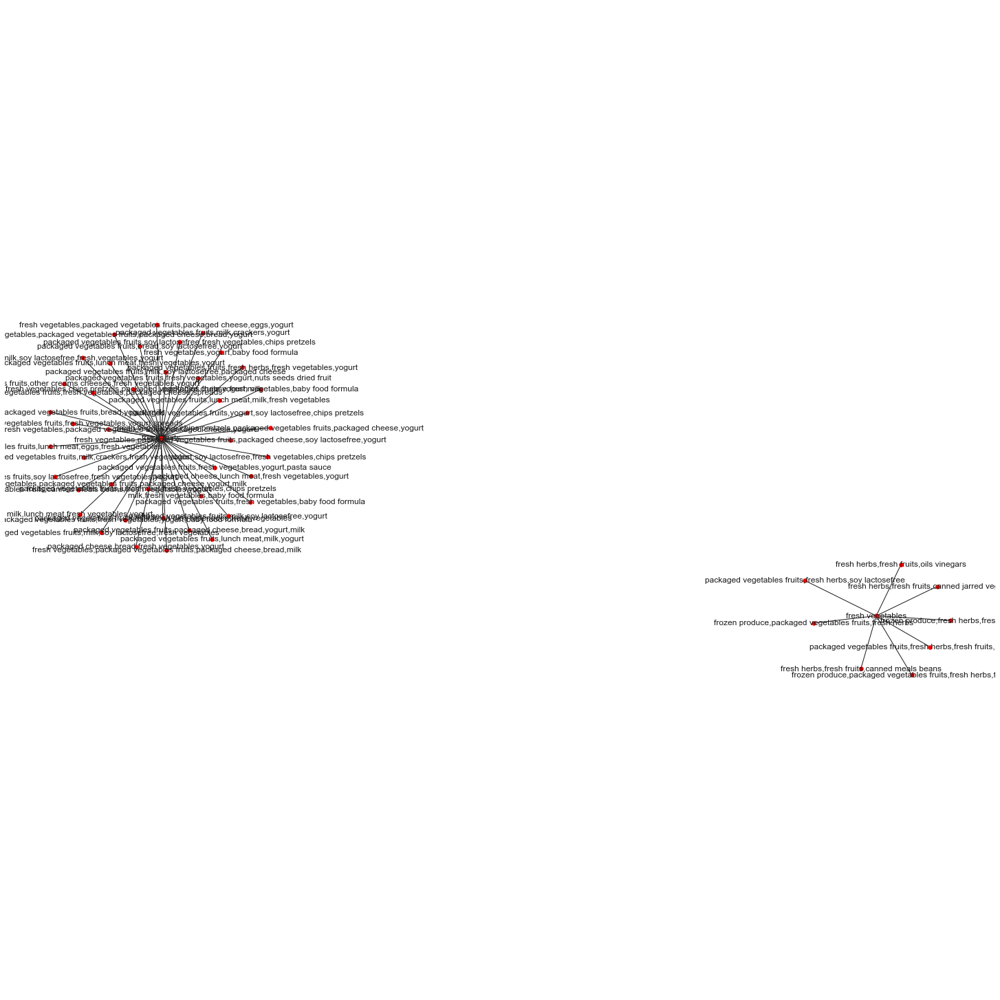

In [107]:
### Plot a basic network graph of the top 50 confidence rules
# Create a copy of the rules and transform the frozensets to strings
rulesToPlot = rulesConfidence.copy(deep=True)
rulesToPlot['LHS'] = [','.join(list(x)) for x in rulesToPlot['antecedents']]
rulesToPlot['RHS'] = [','.join(list(x)) for x in rulesToPlot['consequents']]
# Remove duplicate if reversed rules
rulesToPlot['sortedRow'] = [sorted([a,b]) for a,b in zip(rulesToPlot.LHS, rulesToPlot.RHS)]
rulesToPlot['sortedRow'] = rulesToPlot['sortedRow'].astype(str)
rulesToPlot.drop_duplicates(subset=['sortedRow'], inplace=True)
# Plot
rulesToPlot=rulesToPlot[:50]
fig = plt.figure(figsize=(20, 20)) 
G = nx.from_pandas_edgelist(rulesToPlot, 'LHS', 'RHS')  
# Each node is an itemset (either source or target) and the edges connect the itemsets if they consist of a high confidence rule
nx.draw(G, with_labels=True, node_size=30, node_color="red", pos=nx.spring_layout(G))
plt.axis('equal')
plt.show()
#fig.savefig('figure.svg')
# TRY TO PLOT THE DIRECTION OF SOURCE -> TARGET

## Save Output Files
The tables with complementary relationships and substitute relationships will now be saved to consult on a future occasion.

In [108]:
complementary.reset_index(drop = True, inplace = True)
substitutes.reset_index(drop = True, inplace = True)
complementary.to_csv('./CSV/complementary_relationships.csv')
substitutes.to_csv('./CSV/Substitute_relationships.csv')